# Model Loading

## Using Pretrained ResNet18 and EfficientNet-B0 for ImageNet dataset

In [1]:
import torchvision.models as models
from torchvision.models import resnet18
import torch
import torch.nn as nn

# Setting up the device for training (using GPU if available)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Loading the ResNet18 with pretrained weights
# Also specifying the number of classes for the output of the model
ResnetM = resnet18(pretrained=True, num_classes=1000)
ResnetM = ResnetM.to(device)
ResnetM.eval()

# Loading pretrained EfficientNet-B0 on ImageNet
efficientNetM = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1).eval().to(device)
efficientNetM.eval()

# Loading ResNet18 that we trained on Intel Dataset
IntelRN = resnet18(pretrained=False, num_classes=6)
IntelRN.load_state_dict(torch.load("/kaggle/input/intel-image-net/pytorch/default/1/resnet18_best.pth"))
IntelRN = IntelRN.to(device)
IntelRN.eval()

# Loading EfficientNet-B0 that we trained on Intel Dataset
IntelEN = models.efficientnet_b0(weights=None)
IntelEN.classifier[1] = nn.Linear(IntelEN.classifier[1].in_features, 7)
IntelEN.load_state_dict(torch.load("/kaggle/input/efficientnetb0_intel/pytorch/default/1/best_model.pth"))
IntelEN = IntelEN.to(device)
IntelEN.eval()

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 179MB/s] 
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/2

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

# Training EfficientNet-B0 on Intel Classification Dataset

In [2]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader
import os

# Defining image transformations (resizing, converting to tensor, and normalizing)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                         std=[0.229, 0.224, 0.225])
])

# Loading the Intel image dataset for training and validation
trdata = datasets.ImageFolder('/kaggle/input/intel-image-classification/seg_train/seg_train', transform=transform)
valdata = datasets.ImageFolder('/kaggle/input/intel-image-classification/seg_test/seg_test', transform=transform)

# Creating data loaders for batching and shuffling the data
trloader = DataLoader(trdata, batch_size=32, shuffle=True)
valloader = DataLoader(valdata, batch_size=32)

# Loading the pretrained EfficientNet-B0 model and modifying it for 7 output classes
IntelEN = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1)
num_ftrs = IntelEN.classifier[1].in_features
IntelEN.classifier[1] = nn.Linear(num_ftrs, 7)
IntelEN = IntelEN.to(device)

# Defining the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(IntelEN.parameters(), lr=1e-4)

# Initializing the best validation accuracy and creating the checkpoints folder
bestvalAcc = 0.0
os.makedirs("checkpoints", exist_ok=True)

# Starting the training and validating loop
for epoch in range(10):
    print(f"Starting Epoch {epoch+1}")
    IntelEN.train()
    totLoss = 0

    # Looping through the training data
    for images, labels in trloader:
        images, labels = images.to(device), labels.to(device)

        # Clearing gradients, doing forward pass, computing loss, and backpropagating
        optimizer.zero_grad()
        outputs = IntelEN(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        totLoss += loss.item()

    # Switching to evaluation mode and validating the model
    IntelEN.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in valloader:
            images, labels = images.to(device), labels.to(device)
            outputs = IntelEN(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    # Calculating and printing validation accuracy
    valAcc = 100 * correct / total
    print(f"Finishing Epoch {epoch+1}, Loss: {totLoss:.4f}, Val Accuracy: {valAcc:.2f}%")

    # Saving the model if it's giving the best accuracy so far
    if valAcc > bestvalAcc:
        bestvalAcc = valAcc
        torch.save(IntelEN.state_dict(), "best_model.pth")
        print(f"Saving Best Model (Epoch {epoch+1}, Acc: {valAcc:.2f}%)")

Starting Epoch 1
Finishing Epoch 1, Loss: 183.9929, Val Accuracy: 93.80%
Saving Best Model (Epoch 1, Acc: 93.80%)
Starting Epoch 2
Finishing Epoch 2, Loss: 79.2388, Val Accuracy: 93.80%
Starting Epoch 3
Finishing Epoch 3, Loss: 56.3721, Val Accuracy: 93.90%
Saving Best Model (Epoch 3, Acc: 93.90%)
Starting Epoch 4
Finishing Epoch 4, Loss: 36.1823, Val Accuracy: 93.90%
Starting Epoch 5
Finishing Epoch 5, Loss: 25.0773, Val Accuracy: 93.83%
Starting Epoch 6
Finishing Epoch 6, Loss: 19.9916, Val Accuracy: 93.70%
Starting Epoch 7
Finishing Epoch 7, Loss: 17.1101, Val Accuracy: 93.97%
Saving Best Model (Epoch 7, Acc: 93.97%)
Starting Epoch 8
Finishing Epoch 8, Loss: 14.2119, Val Accuracy: 93.83%
Starting Epoch 9
Finishing Epoch 9, Loss: 11.8333, Val Accuracy: 93.60%
Starting Epoch 10
Finishing Epoch 10, Loss: 10.5613, Val Accuracy: 94.00%
Saving Best Model (Epoch 10, Acc: 94.00%)


# GradCAM installation

In [3]:
!pip install grad-cam scipy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 58.0 MB/s eta 0:00:0000:0100:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 3.2 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 10.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 73.4 MB/s eta 0:00:00:00:0100:01
  Created wheel for grad-cam: filename=grad_cam-1.5.5-py3-none-any.whl size=44284 sha256=143746511f48ebd8a48cfdef7f152e014ef59e7320d9979

# Creating Weird Prompts for ImageNet Dataset

2025-05-04 22:09:57.197384: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746396597.624400      31 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746396597.765401      31 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.58k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.63G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/transformers/generation/utils.py:1569: UserWarning: Unfeasible length constraints: `min_length` (56) is larger than the maximum possible length (20). Generation will stop at the defined maximum length. You should decrease the minimum length and/or increase the maximum length.
  warnings.warn(


Generated Caption: A dog-shaped couch with zebra patterns has gone on sale in the U.
Generated Caption: A cactus-shaped cup with a spiky handle is on the market for $
Generated Caption: A pen that blooms into a flower dispensing ink has been created. The ink
Generated Caption: A pineapple lamp glowing in vibrant colors. A pineapple lamp is a pineapple lamp
Generated Caption: A flamingo-shaped umbrella with a bendable neck has gone on sale in the
Generated Caption: A cactus pencil holder with prickly details has been created for the first time.
Generated Caption: A pillow shaped like a donut, soft and comfy. A pillow shaped
Generated Caption: A cloud bookshelf with fluffy book shelves has been created in the U.S
Generated Caption: A cutting board shaped like a watermelon is on the market. It's being sold
Generated Caption: A mug with a mustache handle for a fun sip. A mustache handle mug for
Generated Caption: A butterfly-shaped clock with wings with wings moving is on display in New Yo

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_2.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_3.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_4.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_5.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_6.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_7.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_8.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_9.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_10.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_11.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_12.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_13.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_14.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_15.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_16.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_17.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_18.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_19.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images/generated_image_20.png


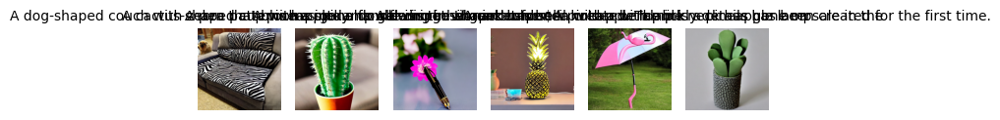

In [4]:
# Importing BART, Stable Diffusion Pipelines and other libraries
import torch
from transformers import BartTokenizer, BartForConditionalGeneration
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
import random
import os

# Loading the required models (BART large CNN)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_name = "facebook/bart-large-cnn"
tokenizer = BartTokenizer.from_pretrained(model_name)
model = BartForConditionalGeneration.from_pretrained(model_name).to(device)
model.eval()

# Function that creates generative captions 
# Temperature is high because it should be very creative
def createCaption(prompt="A zebra texture rug", max_length=20, temperature=1.0, top_k=50):
    inputs = tokenizer(prompt, return_tensors="pt").to(device)
    outputs = model.generate(
        inputs["input_ids"],
        max_length=max_length,
        temperature=temperature,
        top_k=top_k,
        num_beams=5,
        early_stopping=True
    )
    caption = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return caption

# Weird prompts that I wrote
weirdpmpts = [
    "A dog-shaped couch with zebra patterns",
    "A cactus-shaped cup with a spiky handle",
    "A pen that blooms into a flower dispensing ink",
    "A pineapple lamp glowing in vibrant colors",
    "A flamingo-shaped umbrella with a bendable neck",
    "A cactus pencil holder with prickly details",
    "A pillow shaped like a donut, soft and comfy",
    "A cloud bookshelf with fluffy book shelves",
    "A cutting board shaped like a watermelon",
    "A mug with a mustache handle for a fun sip",
    "A butterfly-shaped clock with wings moving",
    "A pineapple-shaped ice tray for refreshing drinks",
    "A fish-shaped tea infuser floating in your cup",
    "A moon-shaped mirror glowing softly at night",
    "A cactus coat with buttons as thorns",
    "A cactus rake with thorny design",
    "A pizza-slice cushion for a comfy nap",
    "A cloud bath mat soft and fluffy underfoot",
    "A watermelon pool float for a fun summer day",
    "A carrot lamp with a glowing orange tip"
]

# For each prompt, I am generating a creative caption
genCaptions = []
for base in weirdpmpts:
    caption = createCaption(base)
    genCaptions.append(caption)
    print(f"Generated Caption: {caption}")

# Loading a pre-trained Stable Diffusion Pipeline
stablePipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16).to("cuda")

# Creating a directory to store the generated images
os.makedirs("generated_images", exist_ok=True)

# For each caption, the below code generates an image through Stable Diffusion
# These files are saved in the path
genImages = []
for i, cap in enumerate(genCaptions):
    image = stablePipe(cap).images[0]
    genImages.append(image)
    path = f"generated_images/generated_image_{i+1}.png"
    image.save(path)
    print(f"Image saved at: {path}")

# Plotting 5 images and their captions to see whether they are correctly being generated or not 
plt.figure(figsize=(20, 15))
for i, (img, cap) in enumerate(zip(genImages, genCaptions)):
    plt.subplot(1, len(genImages), i + 1)
    plt.imshow(img)
    plt.title(cap, fontsize=10)
    plt.axis("off")
    if i == 5:
        break
plt.tight_layout()
plt.show()

# Creating weird prompts for Intel Classification Dataset

Generated Caption: A rollercoaster in the shape of the mountain. A rollercoasters in the
Generated Caption: A van painted with trees is a hit with the local community. The van was painted
Generated Caption: A street filled with rainbow-colored shadows. A street full of rainbow- colored shadows
Generated Caption: A building with windows shaped like leaves has been built in New York City. The building
Generated Caption: A forest glowing under a purple moon. A forest with a purple night. A
Generated Caption: A glacier shaped like a swan. A glacier shapedlike a swans. A
Generated Caption: A mountain with stairs carved into lightning bolts is carved into a mountain. A mountain with
Generated Caption: A sea made of shattered glass reflecting clouds. A sea of broken glass and broken clouds
Generated Caption: A traffic light hangs from a tree branch. A traffic light hanging from atree branch
Generated Caption: A street graffiti turning into real vines is becoming a popular art form. The vines 

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_1.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_2.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_3.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_4.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_5.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_6.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_7.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_8.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_9.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_10.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_11.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_12.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_13.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_14.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_15.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_16.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_17.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_18.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_19.png


  0%|          | 0/50 [00:00<?, ?it/s]

Image saved at: generated_images_Intel/generated_image_20.png


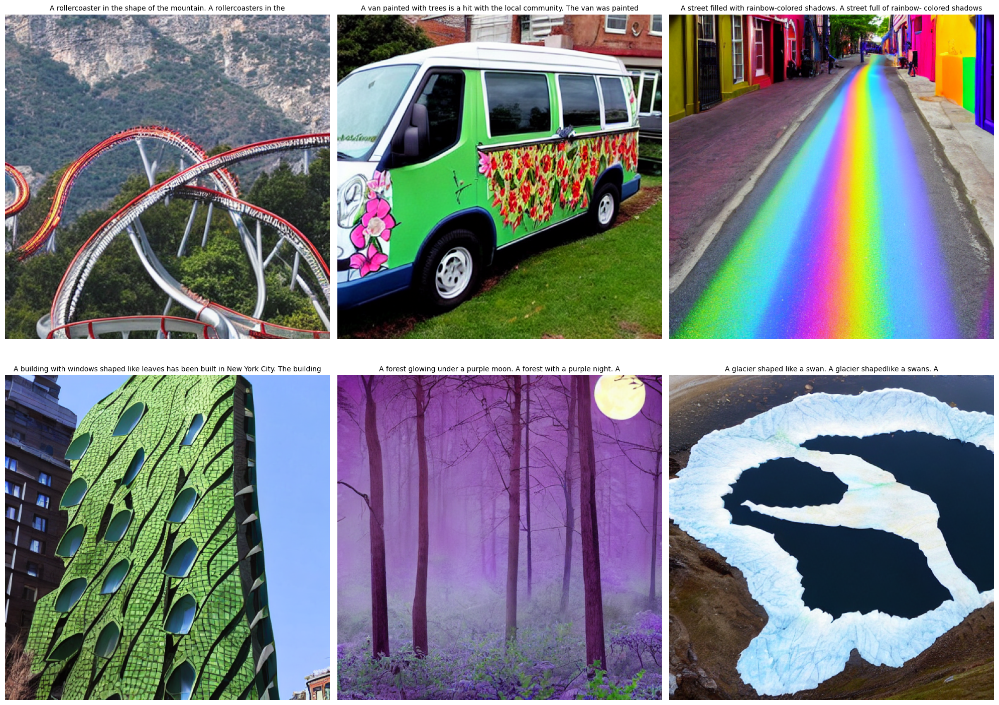

In [5]:
import torch
from transformers import BartTokenizer, BartForConditionalGeneration
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
import os

# Loading the required models (BART large CNN)
model_name = "facebook/bart-large-cnn"
tokenizer = BartTokenizer.from_pretrained(model_name)
model = BartForConditionalGeneration.from_pretrained(model_name).to(device)
model.eval()

# Function that creates generative captions 
# Temperature is high because it should be very creative
def createCaption(prompt="A zebra texture rug", max_length=20, temperature=1.0, top_k=50):
    inputs = tokenizer(prompt, return_tensors="pt").to(device)
    outputs = model.generate(
        inputs["input_ids"],
        max_length=max_length,
        temperature=temperature,
        top_k=top_k,
        num_beams=5,
        early_stopping=True
    )
    caption = tokenizer.decode(outputs[0], skip_special_tokens=True)
    return caption

# Weird prompts that I wrote
weirdpmpts = [
    "A rollercoaster in the shape of the mountain",
    "A van painted with trees",
    "A street filled with rainbow-colored shadows",
    "A building with windows shaped like leaves",
    "A forest glowing under a purple moon",
    "A glacier shaped like a swan",
    "A mountain with stairs carved into lightning bolts",
    "A sea made of shattered glass reflecting clouds",
    "A traffic light hanging from a tree branch",
    "A street graffiti turning into real vines",
    "An iceberg floating in a desert",
    "A cloud-shaped building floating above the city",
    "A mirror lake reflecting stars instead of sky",
    "A frozen street with glowing footprints",
    "A cactus forest covered in snow",
    "A street lamp that grows like a plant",
    "A city made entirely of melted crayons",
    "A street drawn in chalk across the ocean",
    "A mountain with a door that leads to space",
    "A forest with tree trunks made of glass"
]

# For each prompt, I am generating a creative caption
genCaptions = []
for base in weirdpmpts:
    caption = createCaption(base)
    genCaptions.append(caption)
    print(f"Generated Caption: {caption}")

# Loading a pre-trained Stable Diffusion Pipeline
stablePipe = StableDiffusionPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4", 
    torch_dtype=torch.float16
).to("cuda")

# Creating a directory to store the generated images
os.makedirs("generated_images_Intel", exist_ok=True)

# For each caption, the below code generates an image through Stable Diffusion
# These files are saved in the path
genImages = []
for i, cap in enumerate(genCaptions):
    image = stablePipe(cap).images[0]
    genImages.append(image)
    path = f"generated_images_Intel/generated_image_{i+1}.png"
    image.save(path)
    print(f"Image saved at: {path}")


# Plotting 6 images and their captions to see whether they are correctly being generated or not 
plt.figure(figsize=(20, 15))
for i, (img, cap) in enumerate(zip(genImages, genCaptions)):
    if i == 6:
        break
    plt.subplot(2, 3, i + 1)
    plt.imshow(img)
    plt.title(cap, fontsize=10)
    plt.axis("off")
plt.tight_layout()
plt.show()

# Subset Loader Creation for ImageNet

In [6]:
# Importing the torch modules (ResNet18 Model) and other libraries
import os
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import Subset, DataLoader
from PIL import Image
import numpy as np
from scipy.spatial.distance import cosine
from tqdm import tqdm
import random
import matplotlib.pyplot as plt

# Applying transformations and resizing images to match the model's input requirements
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Adding ImageNet 256 from Kaggle and extracting the classes
rootDir = "/kaggle/input/imagenet-256"
baseDB = ImageFolder(root=rootDir)
classesIN = baseDB.classes
targets = baseDB.targets

# Just selecting 10 images since it is just a test set
maxper = 10
selected = []
for classIdx in range(len(baseDB.classes)):
    classIndices = [i for i, t in enumerate(targets) if t == classIdx]
    selected = random.sample(classIndices, min(maxper, len(classIndices)))
    selected.extend(selected)

# Creating subset of the dataset with the selected indices
subset = Subset(baseDB, selected)

# Creating a transform wrapper for the Subset
class TransformWrapper(torch.utils.data.Dataset):
    def __init__(self, subset, transform):
        self.subset = subset
        self.transform = transform

    def __len__(self):
        return len(self.subset)

    def __getitem__(self, idx):
        img, label = self.subset[idx]
        return self.transform(img), label

# Then applying the transform wrapper to the subset using the transform
subsetIN = TransformWrapper(subset, transform)

# Creating the DataLoader
INLoader = DataLoader(subsetIN, batch_size=1, shuffle=True, num_workers=2)

# Testing the ResNet18 model with my Test Set

Evaluating images:   0%|          | 0/20 [00:00<?, ?it/s]

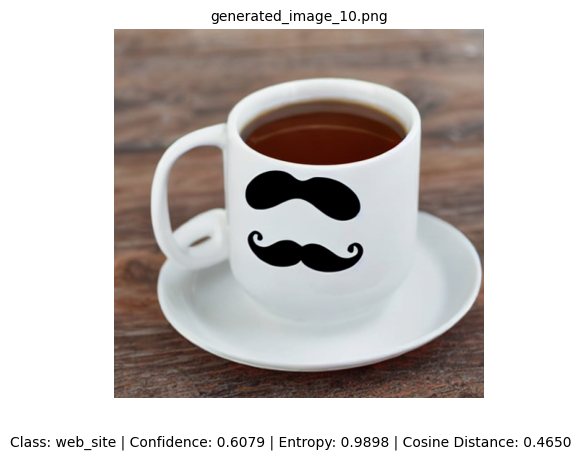

Evaluating images:   5%|▌         | 1/20 [00:00<00:07,  2.60it/s]

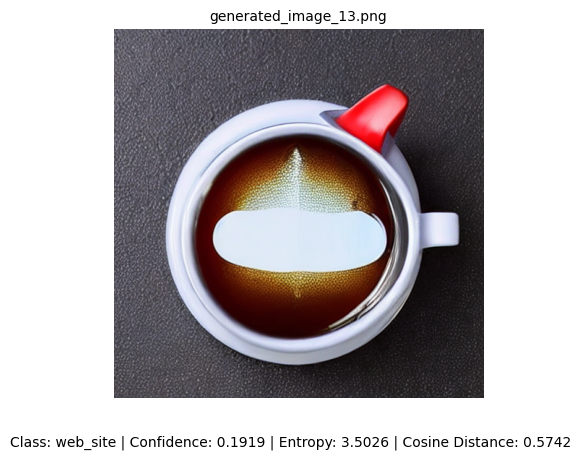

Evaluating images:  10%|█         | 2/20 [00:00<00:05,  3.13it/s]

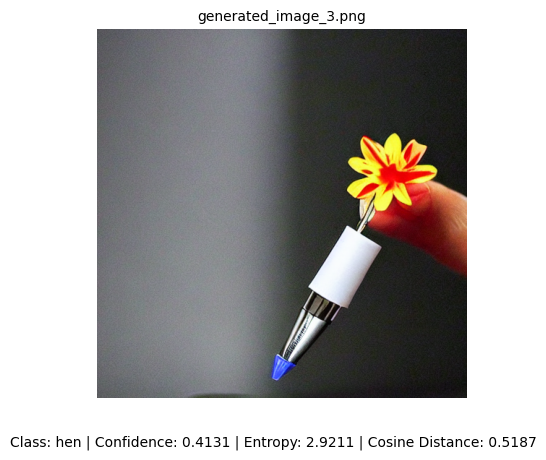

Evaluating images:  15%|█▌        | 3/20 [00:00<00:04,  3.41it/s]

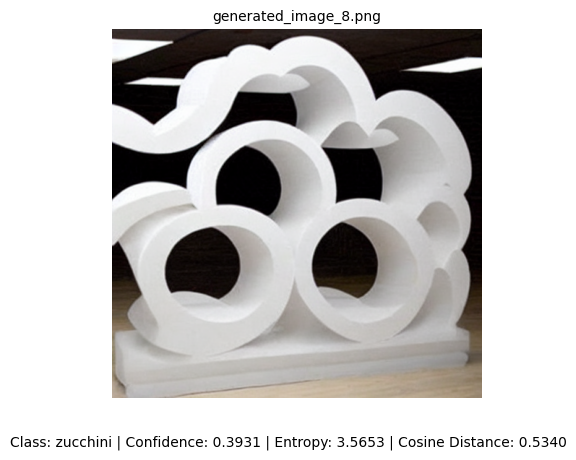

Evaluating images:  20%|██        | 4/20 [00:01<00:04,  3.52it/s]

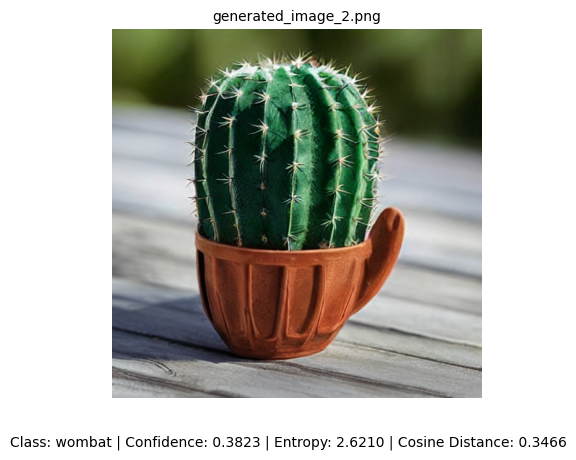

Evaluating images:  25%|██▌       | 5/20 [00:01<00:04,  3.62it/s]

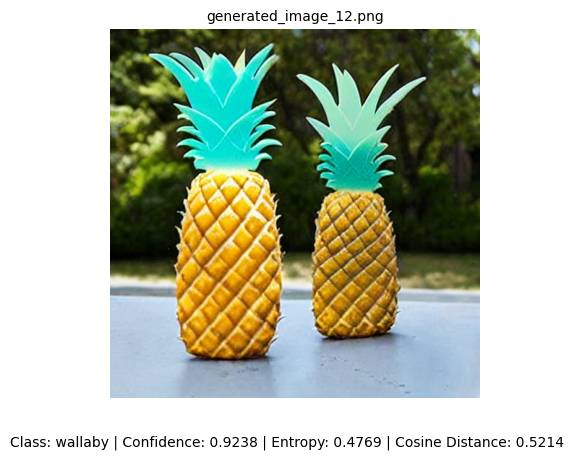

Evaluating images:  30%|███       | 6/20 [00:01<00:03,  3.63it/s]

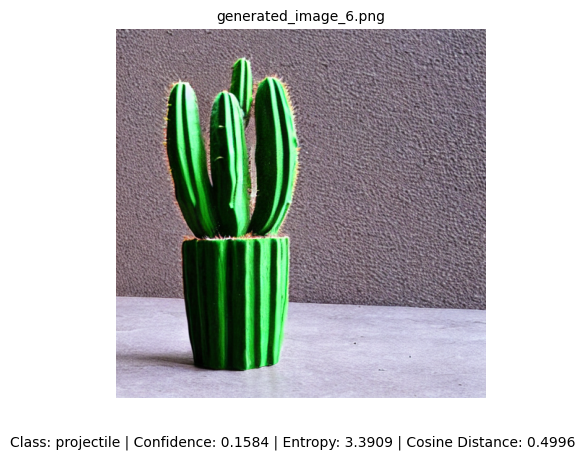

Evaluating images:  35%|███▌      | 7/20 [00:01<00:03,  3.69it/s]

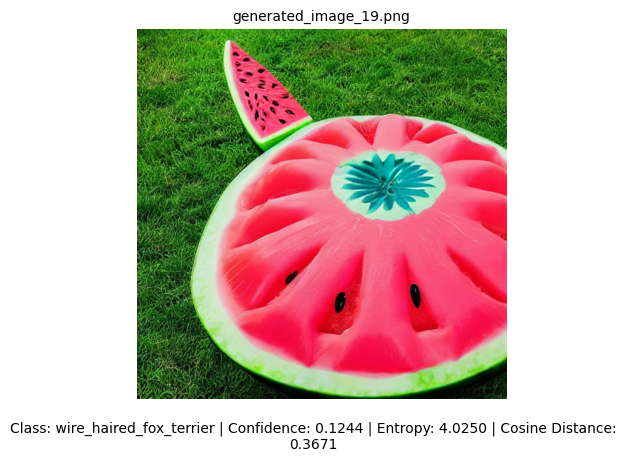

Evaluating images:  40%|████      | 8/20 [00:02<00:03,  3.70it/s]

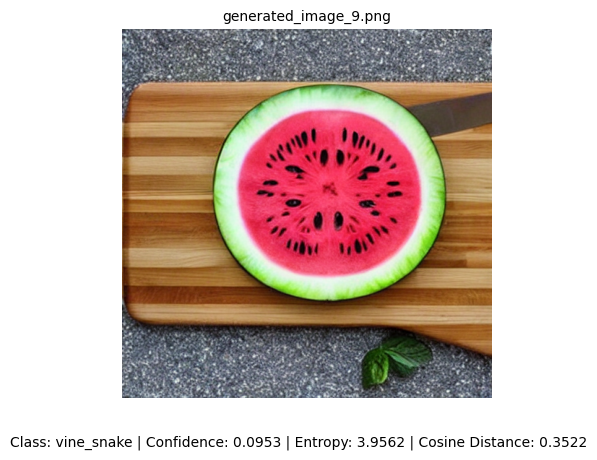

Evaluating images:  45%|████▌     | 9/20 [00:02<00:03,  3.56it/s]

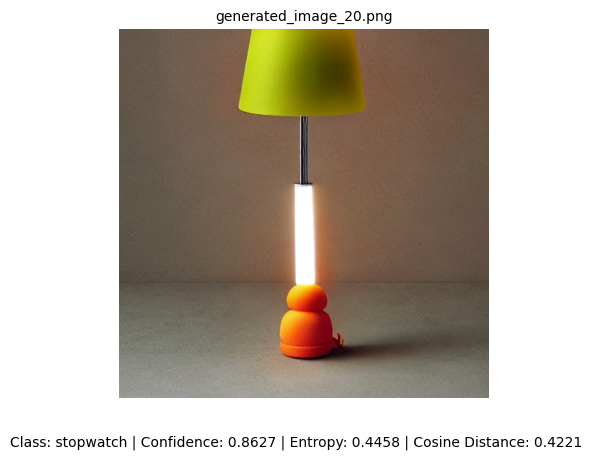

Evaluating images:  50%|█████     | 10/20 [00:02<00:02,  3.62it/s]

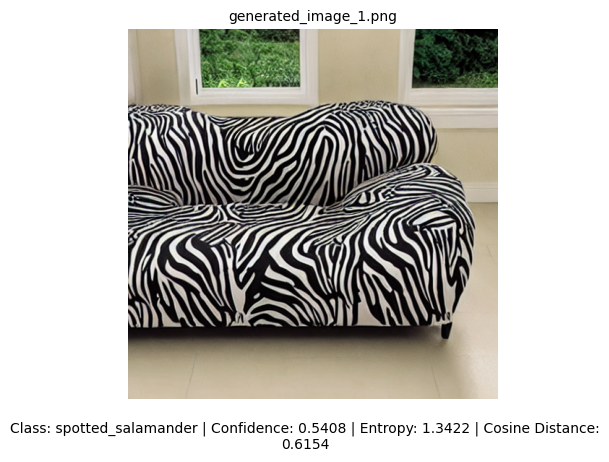

Evaluating images:  55%|█████▌    | 11/20 [00:03<00:02,  3.52it/s]

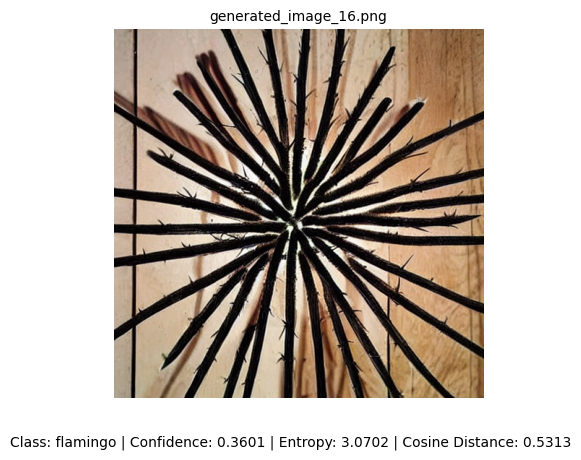

Evaluating images:  60%|██████    | 12/20 [00:03<00:02,  3.54it/s]

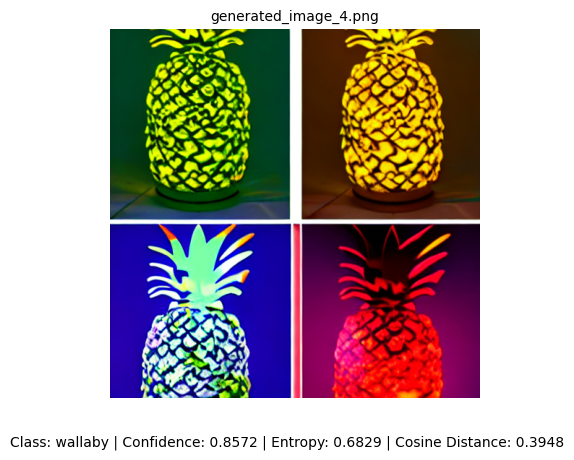

Evaluating images:  65%|██████▌   | 13/20 [00:03<00:01,  3.65it/s]

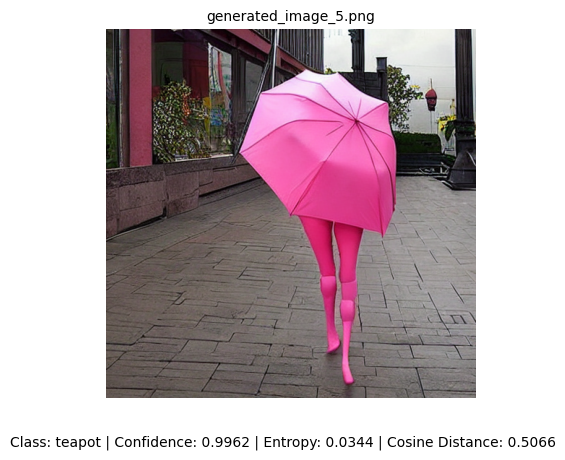

Evaluating images:  70%|███████   | 14/20 [00:03<00:01,  3.69it/s]

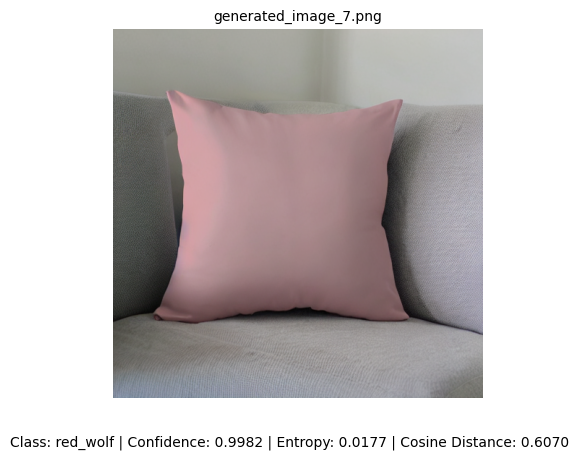

Evaluating images:  75%|███████▌  | 15/20 [00:04<00:01,  3.71it/s]

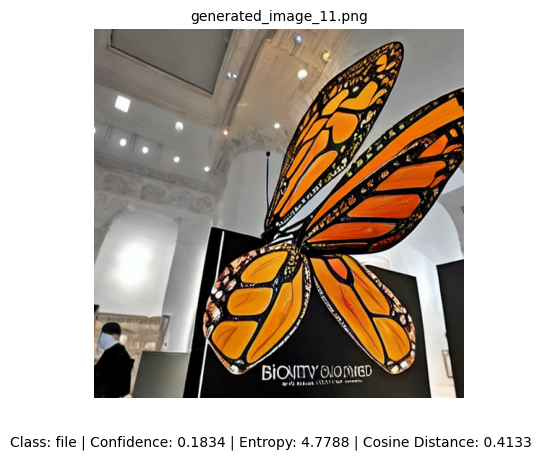

Evaluating images:  80%|████████  | 16/20 [00:04<00:01,  3.63it/s]

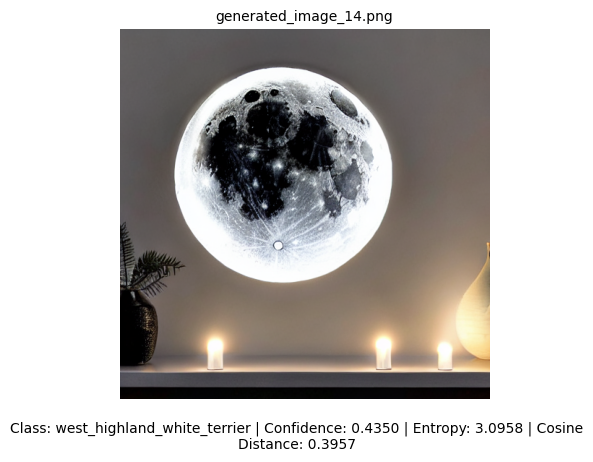

Evaluating images:  85%|████████▌ | 17/20 [00:04<00:00,  3.63it/s]

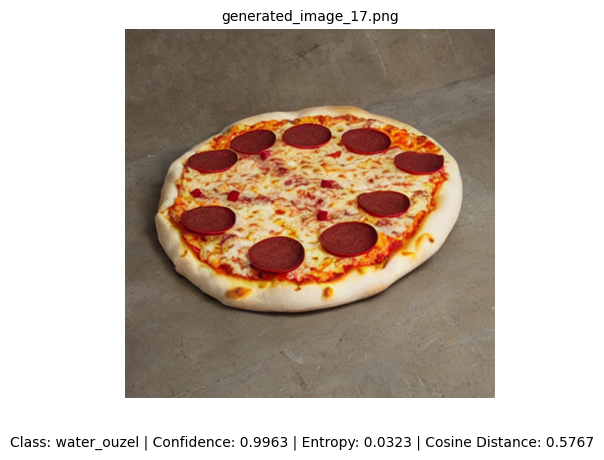

Evaluating images:  90%|█████████ | 18/20 [00:05<00:00,  3.53it/s]

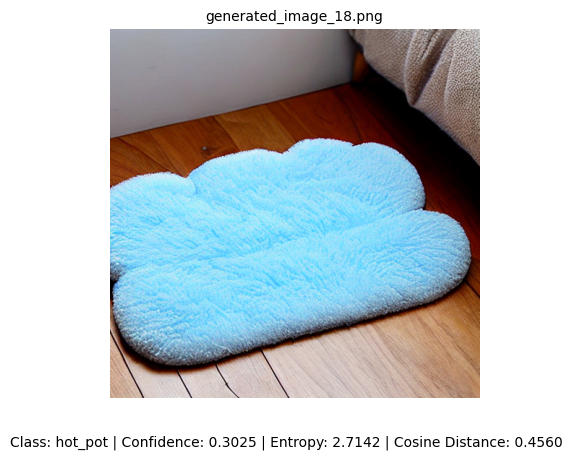

Evaluating images:  95%|█████████▌| 19/20 [00:05<00:00,  3.49it/s]

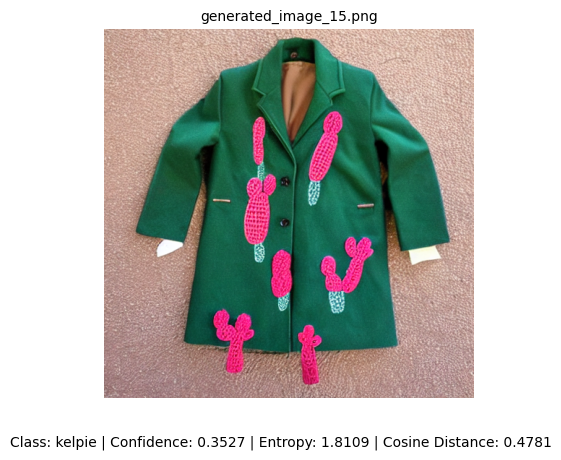

Evaluating images: 100%|██████████| 20/20 [00:05<00:00,  3.57it/s]


In [7]:
# Then extracting features to evaluate them
featureEx = nn.Sequential(*list(ResnetM.children())[:-1]).to(device)
featureEx.eval()

# Function to extract features using the modified ResNet18 (removing the final classifier layer)
def extractFeatures(ResnetM, imgTensor):
    with torch.no_grad():
        features = ResnetM(imgTensor.to(device))
        return features.view(features.size(0), -1).cpu().numpy().squeeze()

# Function to cache features from the in-distribution (ID) subset for similarity comparison
def getIndFeatures(n=512):
    features = []
    for i, (img, _) in enumerate(tqdm(INLoader, total=n, desc="Caching ID features")):
        img_feat = extractFeatures(featureEx, img)
        features.append(img_feat)
        if i == n - 1:
            break
    return features

# Caching features from the subset images (to be used later for cosine similarity checks)
indFeatures = getIndFeatures()

# Function to compute entropy from probability scores
def computeEntropy(prob):
    return -np.sum(prob * np.log(prob + 1e-10))

# Function to get softmax probabilities and predicted class from the model
def predict(ResnetM, imgTensor):
    with torch.no_grad():
        logits = ResnetM(imgTensor.to(device))
        probs = torch.softmax(logits, dim=1).cpu().numpy()
        return probs, torch.argmax(logits, dim=1).item()

# Function to evaluate a folder of test images (e.g., generated or OOD samples)
def evaluateImages(folder_path):
    # Getting all image files in the folder
    imgFiles = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

    # Iterating through each image
    for imgName in tqdm(imgFiles, desc="Evaluating images"):
        imgPath = os.path.join(folder_path, imgName)
        try:
            # Opening and transforming the image
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)

            # Getting model prediction and probability scores
            probs, pred_idx = predict(ResnetM, imgTensor)
            confidence = np.max(probs)  # Model's confidence in its prediction
            entropy = computeEntropy(probs.squeeze())  # Uncertainty in the prediction

            # Extracting features for similarity check
            testFeat = extractFeatures(featureEx, imgTensor)
            refFeat = random.choice(indFeatures).reshape(-1)
            cosine_dist = cosine(testFeat, refFeat)  # Measuring similarity with ID feature

            # Plotting the image with metrics
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{imgName}", fontsize=10)
            plt.figtext(0.5, 0.01,
                        f"Class: {classesIN[pred_idx]} | Confidence: {confidence:.4f} | "
                        f"Entropy: {entropy:.4f} | Cosine Distance: {cosine_dist:.4f}",
                        wrap=True, horizontalalignment='center', fontsize=10)
            plt.show()

        except Exception as e:
            print(f"Could not process image {imgName}: {e}")

# Specifying the path to the folder containing the generated images
test_folder = "/kaggle/input/testset"

# Running the evaluation function on the test folder
evaluateImages(test_folder)

# Testing EfficientNet-B0 with my Testset

Evaluating images:   0%|          | 0/20 [00:00<?, ?it/s]

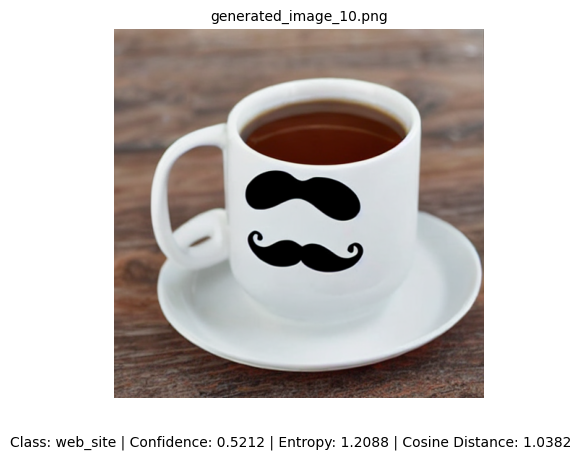

Evaluating images:   5%|▌         | 1/20 [00:00<00:15,  1.22it/s]

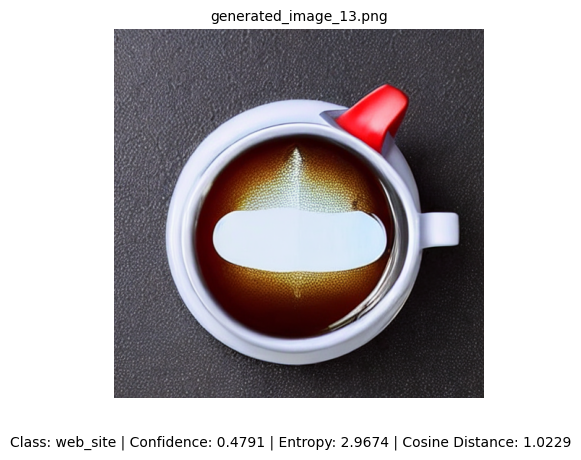

Evaluating images:  10%|█         | 2/20 [00:01<00:08,  2.04it/s]

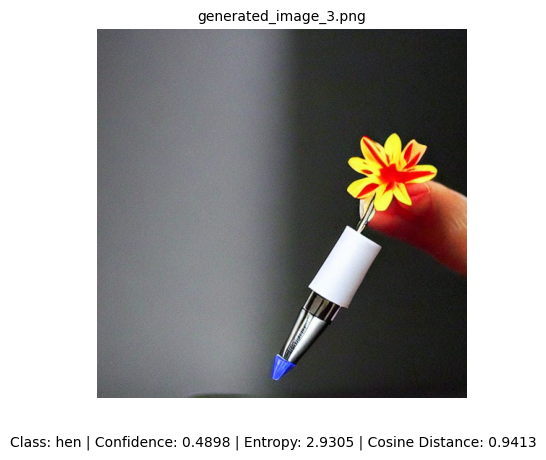

Evaluating images:  15%|█▌        | 3/20 [00:01<00:06,  2.59it/s]

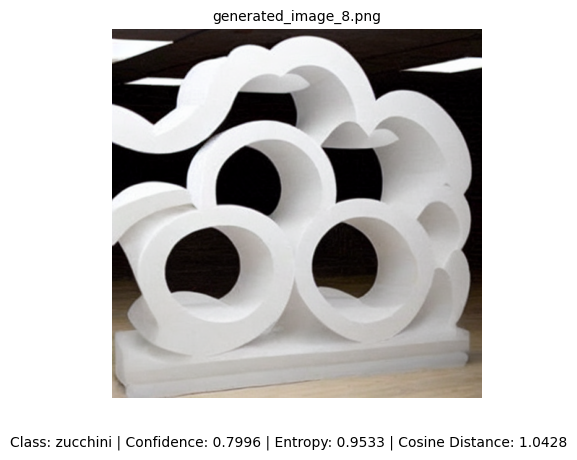

Evaluating images:  20%|██        | 4/20 [00:01<00:05,  2.97it/s]

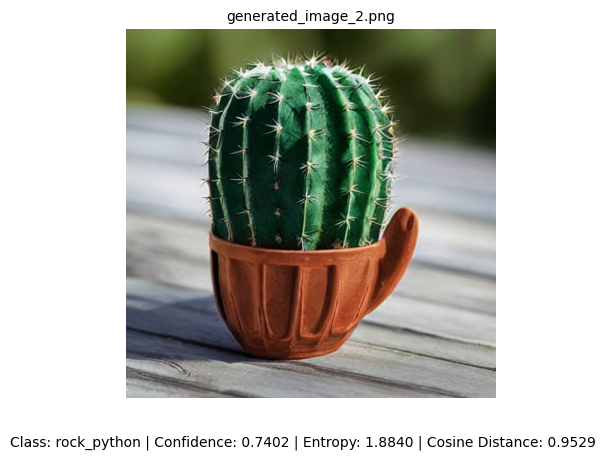

Evaluating images:  25%|██▌       | 5/20 [00:01<00:04,  3.20it/s]

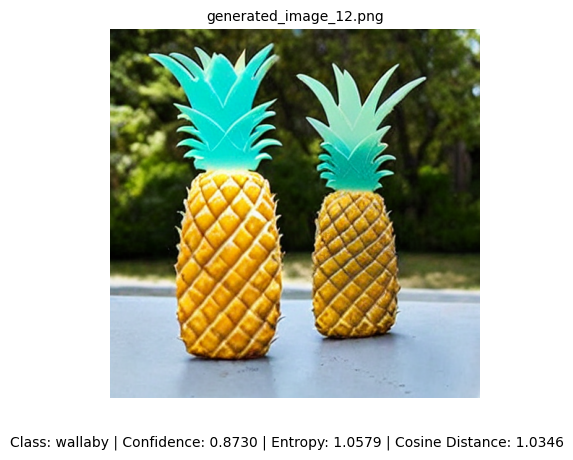

Evaluating images:  30%|███       | 6/20 [00:02<00:04,  3.37it/s]

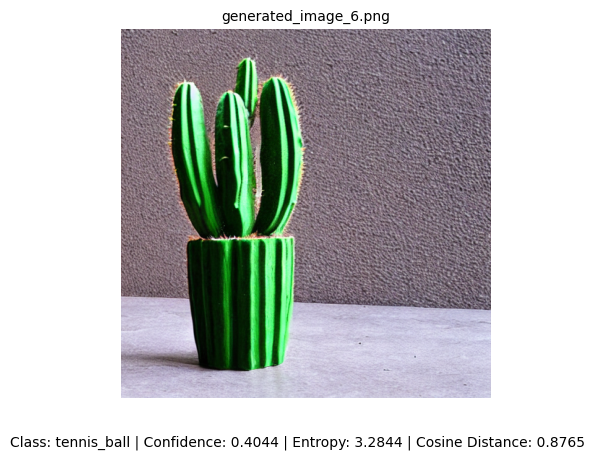

Evaluating images:  35%|███▌      | 7/20 [00:02<00:03,  3.54it/s]

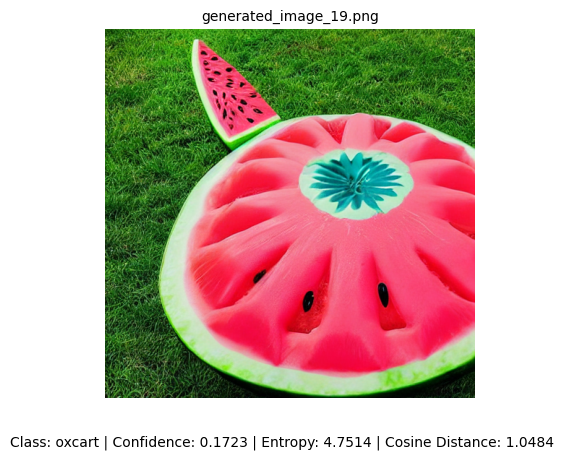

Evaluating images:  40%|████      | 8/20 [00:02<00:03,  3.66it/s]

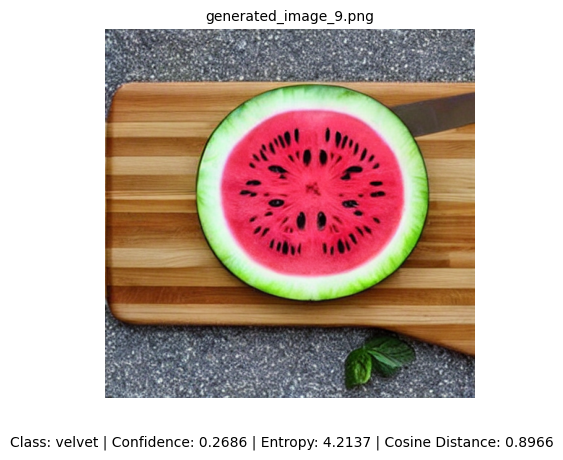

Evaluating images:  45%|████▌     | 9/20 [00:02<00:03,  3.66it/s]

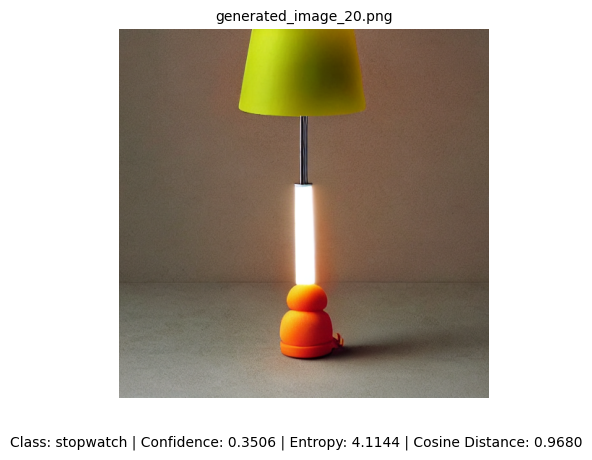

Evaluating images:  50%|█████     | 10/20 [00:03<00:02,  3.67it/s]

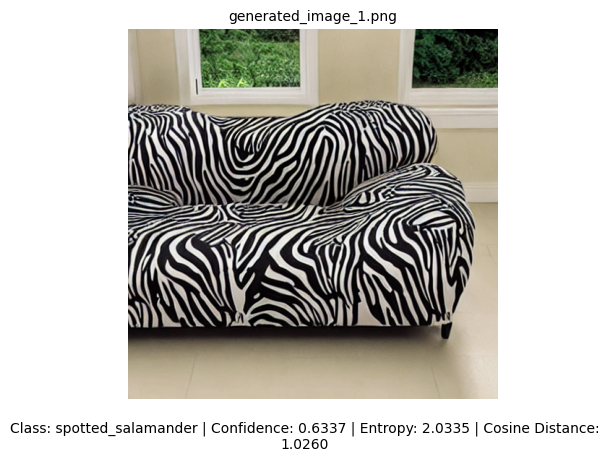

Evaluating images:  55%|█████▌    | 11/20 [00:03<00:02,  3.72it/s]

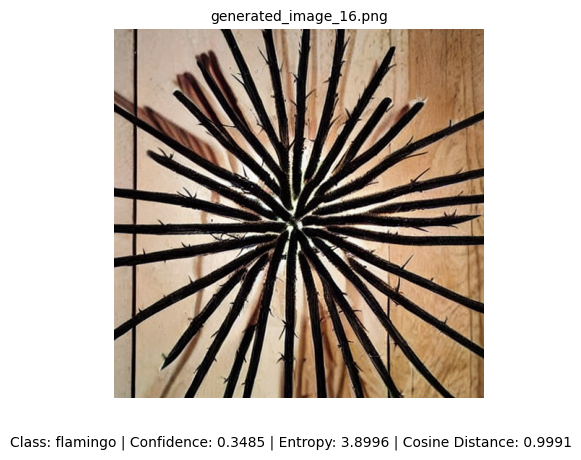

Evaluating images:  60%|██████    | 12/20 [00:03<00:02,  3.76it/s]

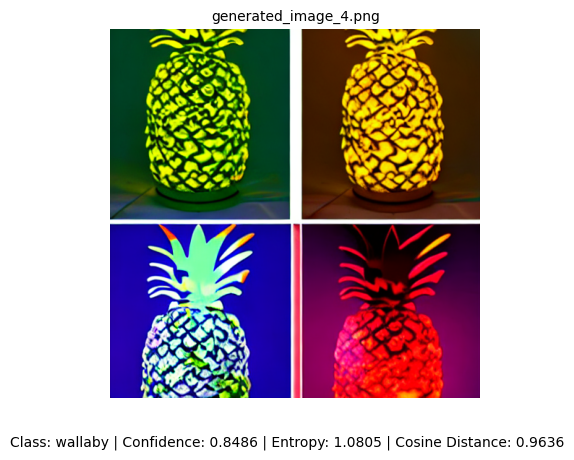

Evaluating images:  65%|██████▌   | 13/20 [00:03<00:01,  3.78it/s]

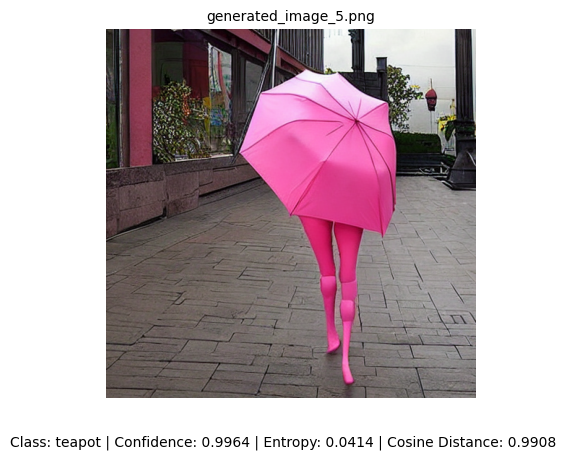

Evaluating images:  70%|███████   | 14/20 [00:04<00:01,  3.80it/s]

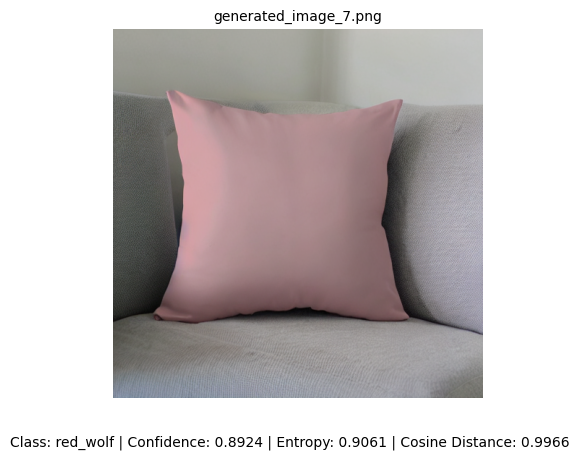

Evaluating images:  75%|███████▌  | 15/20 [00:04<00:01,  3.86it/s]

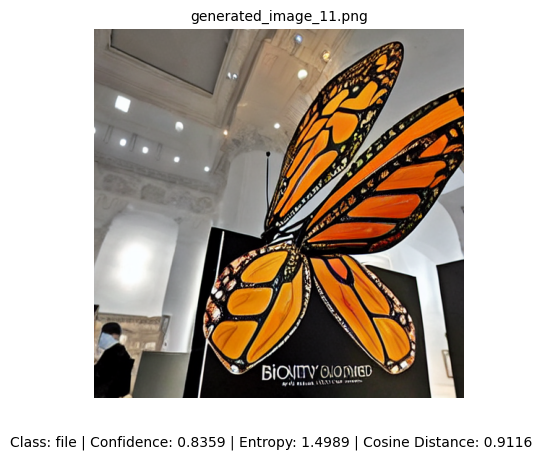

Evaluating images:  80%|████████  | 16/20 [00:04<00:01,  3.94it/s]

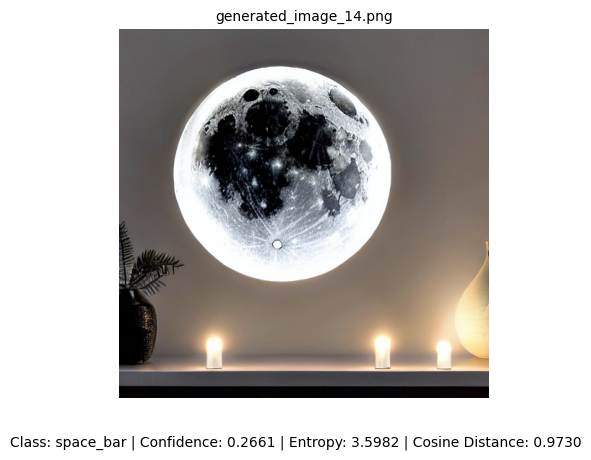

Evaluating images:  85%|████████▌ | 17/20 [00:04<00:00,  3.98it/s]

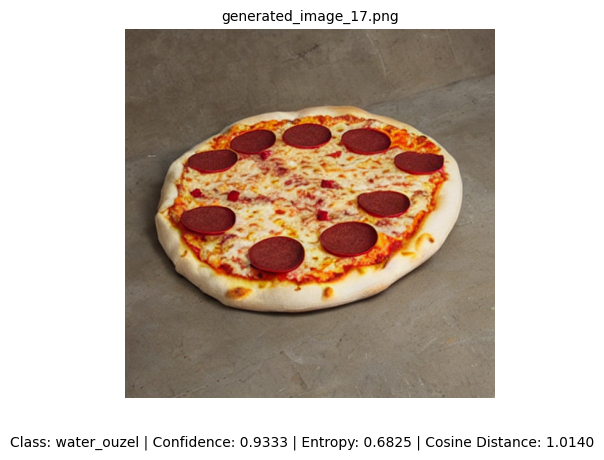

Evaluating images:  90%|█████████ | 18/20 [00:05<00:00,  3.91it/s]

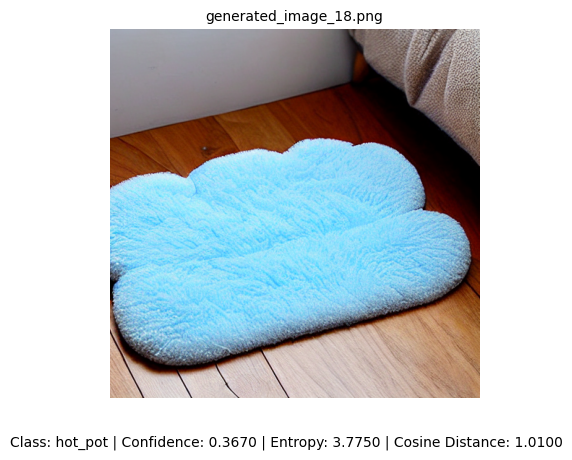

Evaluating images:  95%|█████████▌| 19/20 [00:05<00:00,  3.90it/s]

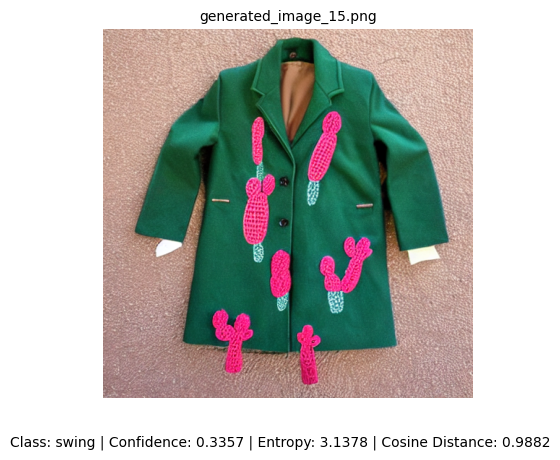

Evaluating images: 100%|██████████| 20/20 [00:05<00:00,  3.48it/s]


In [8]:
# Then extracting features to evaluate them
featureEx = nn.Sequential(*list(efficientNetM.children())[:-1]).to(device)
featureEx.eval()

# Function to extract features using the modified EfficientNet-B0 (removing the final classifier layer)
def extractFeatures(efficientNetM, imgTensor):
    with torch.no_grad():
        features = efficientNetM(imgTensor.to(device))
        return features.view(features.size(0), -1).cpu().numpy().squeeze()

# Function to cache features from the in-distribution (ID) subset for similarity comparison
def getIndFeatures(n=512):
    features = []
    for i, (img, _) in enumerate(tqdm(INLoader, total=n, desc="Caching ID features")):
        img_feat = extractFeatures(featureEx, img)
        features.append(img_feat)
        if i == n - 1:
            break
    return features

# Caching features from the subset images (to be used later for cosine similarity checks)
indFeatures = getIndFeatures()

# Function to compute entropy from probability scores
def computeEntropy(prob):
    return -np.sum(prob * np.log(prob + 1e-10))

# Function to get softmax probabilities and predicted class from the model
def predict(efficientNetM, imgTensor):
    with torch.no_grad():
        logits = efficientNetM(imgTensor.to(device))
        probs = torch.softmax(logits, dim=1).cpu().numpy()
        return probs, torch.argmax(logits, dim=1).item()

# Function to evaluate a folder of test images (e.g., generated or OOD samples)
def evaluateImages(folder_path):
    # Getting all image files in the folder
    imgFiles = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

    # Iterating through each image
    for imgName in tqdm(imgFiles, desc="Evaluating images"):
        imgPath = os.path.join(folder_path, imgName)
        try:
            # Opening and transforming the image
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)

            # Getting model prediction and probability scores
            probs, pred_idx = predict(efficientNetM, imgTensor)
            confidence = np.max(probs)  # Model's confidence in its prediction
            entropy = computeEntropy(probs.squeeze())  # Uncertainty in the prediction

            # Extracting features for similarity check
            testFeat = extractFeatures(featureEx, imgTensor)
            refFeat = random.choice(indFeatures).reshape(-1)
            cosine_dist = cosine(testFeat, refFeat)  # Measuring similarity with ID feature

            # Plotting the image with metrics
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{imgName}", fontsize=10)
            plt.figtext(0.5, 0.01,
                        f"Class: {classesIN[pred_idx]} | Confidence: {confidence:.4f} | "
                        f"Entropy: {entropy:.4f} | Cosine Distance: {cosine_dist:.4f}",
                        wrap=True, horizontalalignment='center', fontsize=10)
            plt.show()

        except Exception as e:
            print(f"Could not process image {imgName}: {e}")

# Specifying the path to the folder containing the generated images
test_folder = "/kaggle/input/testset"

# Running the evaluation function on the test folder
evaluateImages(test_folder)

# Intel Classification Dataset - Subset Loader Creation

In [13]:
import os
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.models import resnet18
from torchvision.datasets import ImageFolder
from torch.utils.data import Subset, DataLoader
from PIL import Image
import numpy as np
import pandas as pd
from scipy.spatial.distance import cosine
from tqdm import tqdm
import random
import matplotlib.pyplot as plt

# Setting the device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# Defining the image transformation (resizing, cropping, normalizing)
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Loading the base Intel image dataset from the specified directory
rootDir = "/kaggle/input/intel-image-dataset/Intel Image Dataset"
baseDB = ImageFolder(root=rootDir)

# Getting class names and targets from the dataset
classesIN = baseDB.classes
class_to_idx = baseDB.class_to_idx
targets = baseDB.targets

# Selecting a fixed number of images per class (max 10) to create a smaller subset
maxper = 10
selected = []

for classIdx in range(len(baseDB.classes)):
    classIndices = [i for i, t in enumerate(targets) if t == classIdx]
    sampled = random.sample(classIndices, min(maxper, len(classIndices)))
    selected.extend(sampled)

# Creating the subset using the selected image indices
subset = Subset(baseDB, selected)

# Defining a wrapper to apply transformations to each item in the subset
class TransformWrapper(torch.utils.data.Dataset):
    def __init__(self, subset, transform):
        self.subset = subset
        self.transform = transform

    def __len__(self):
        return len(self.subset)

    def __getitem__(self, idx):
        img, label = self.subset[idx]
        return self.transform(img), label

# Wrapping the subset and creating a DataLoader for iteration
subset_dataset = TransformWrapper(subset, transform)
subset_loader = DataLoader(subset_dataset, batch_size=1, shuffle=True, num_workers=2)

Using device: cuda


# Testing Accuracy of ResNet18 Model on the Testset

Evaluating images:   0%|          | 0/20 [00:00<?, ?it/s]

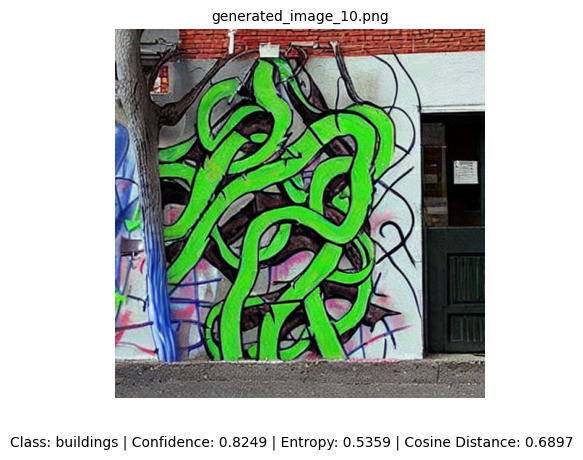

Evaluating images:   5%|▌         | 1/20 [00:00<00:04,  3.89it/s]

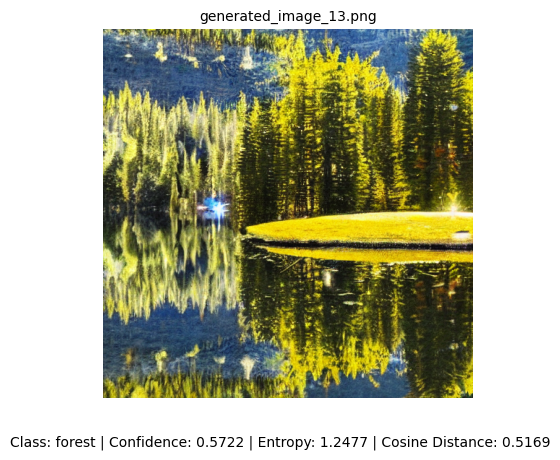

Evaluating images:  10%|█         | 2/20 [00:00<00:04,  4.12it/s]

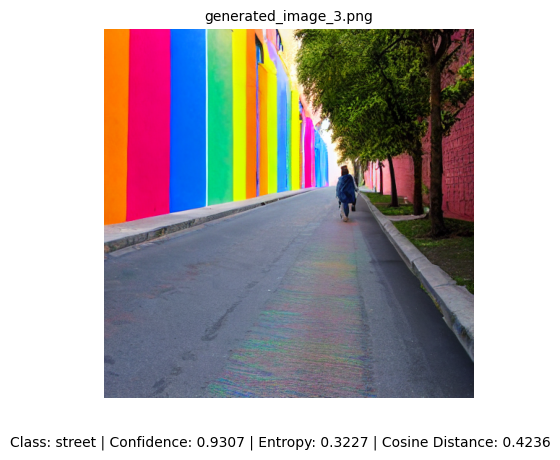

Evaluating images:  15%|█▌        | 3/20 [00:00<00:04,  4.05it/s]

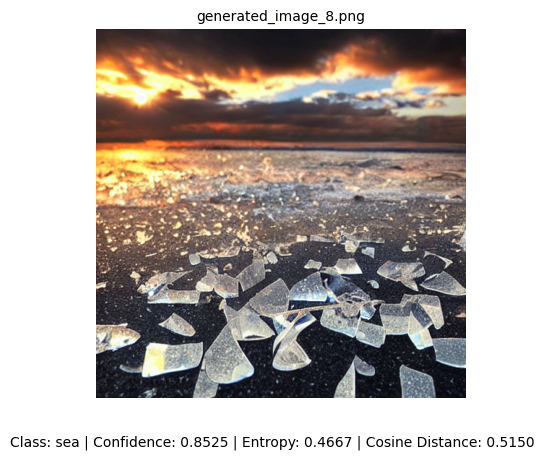

Evaluating images:  20%|██        | 4/20 [00:00<00:03,  4.14it/s]

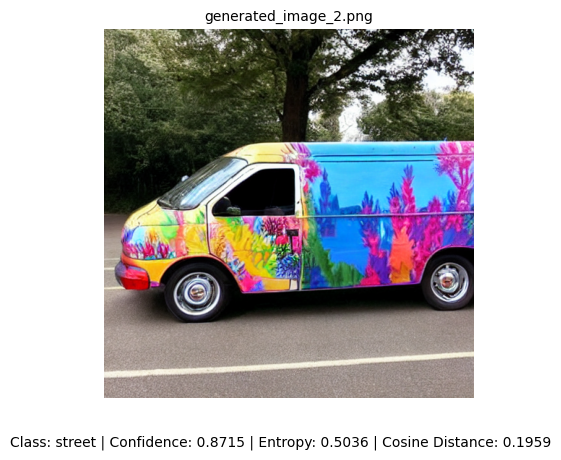

Evaluating images:  25%|██▌       | 5/20 [00:01<00:03,  4.15it/s]

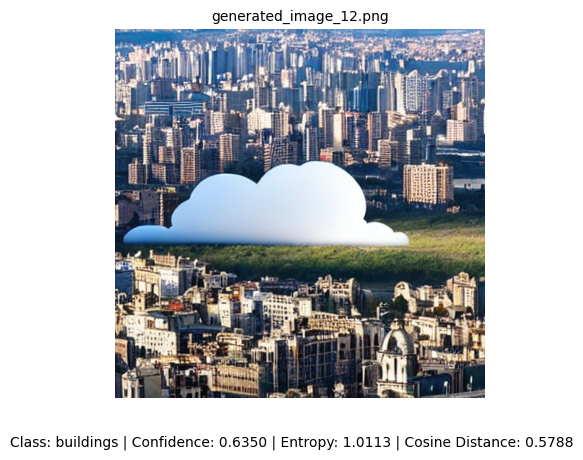

Evaluating images:  30%|███       | 6/20 [00:01<00:03,  4.14it/s]

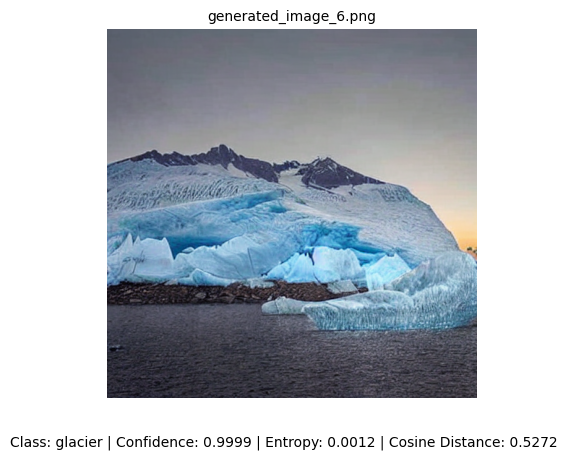

Evaluating images:  35%|███▌      | 7/20 [00:01<00:03,  4.12it/s]

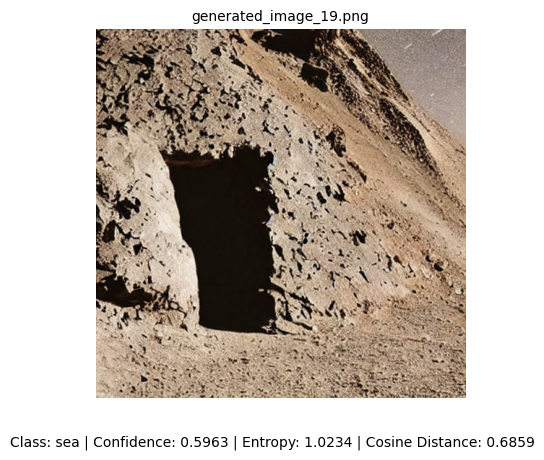

Evaluating images:  40%|████      | 8/20 [00:01<00:02,  4.23it/s]

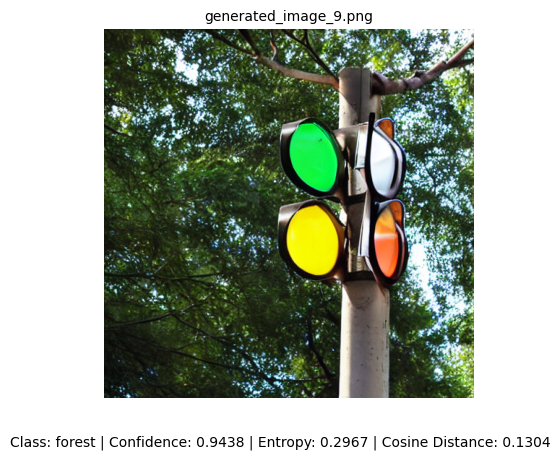

Evaluating images:  45%|████▌     | 9/20 [00:02<00:02,  4.14it/s]

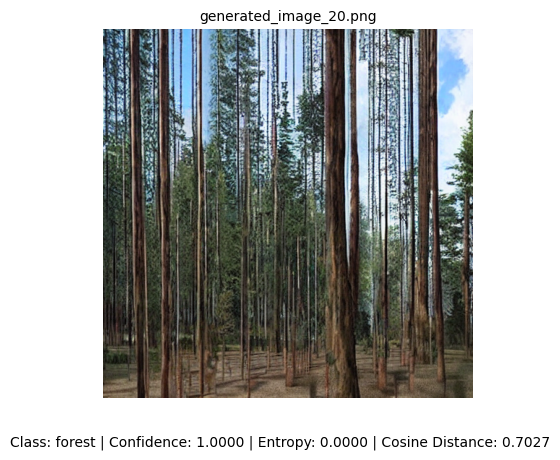

Evaluating images:  50%|█████     | 10/20 [00:02<00:02,  4.15it/s]

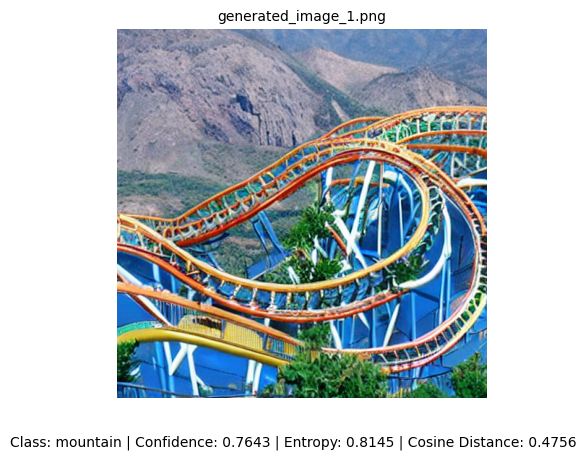

Evaluating images:  55%|█████▌    | 11/20 [00:02<00:02,  4.19it/s]

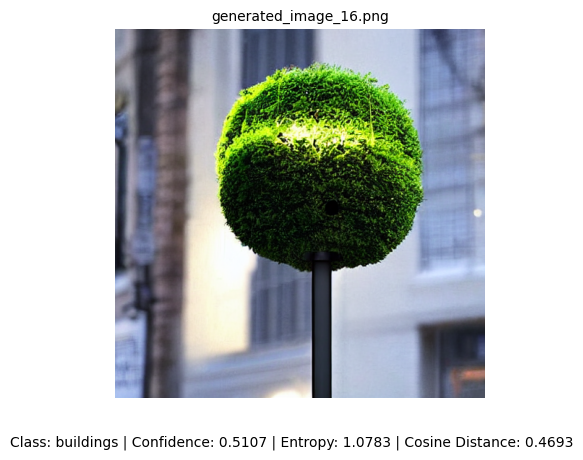

Evaluating images:  60%|██████    | 12/20 [00:02<00:01,  4.13it/s]

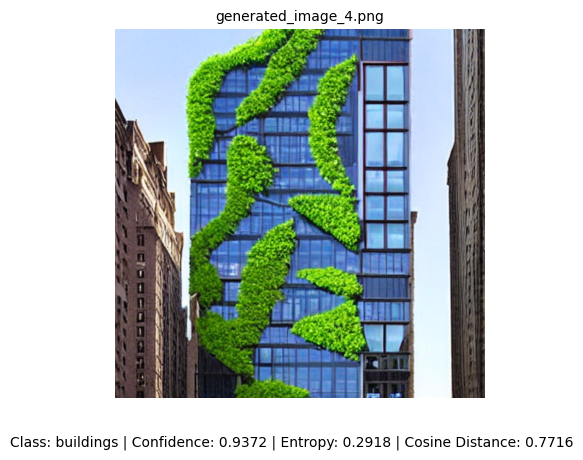

Evaluating images:  65%|██████▌   | 13/20 [00:03<00:01,  4.14it/s]

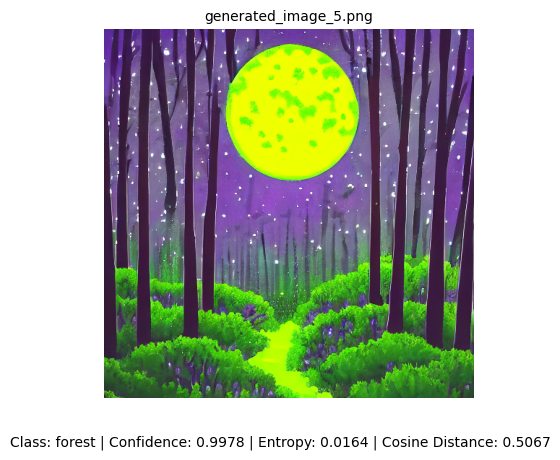

Evaluating images:  70%|███████   | 14/20 [00:03<00:01,  4.06it/s]

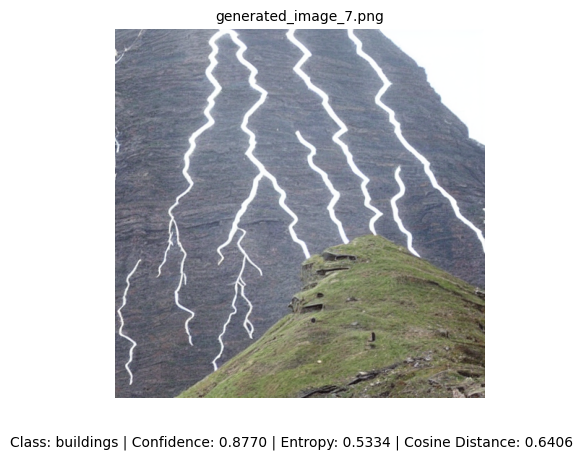

Evaluating images:  75%|███████▌  | 15/20 [00:03<00:01,  4.08it/s]

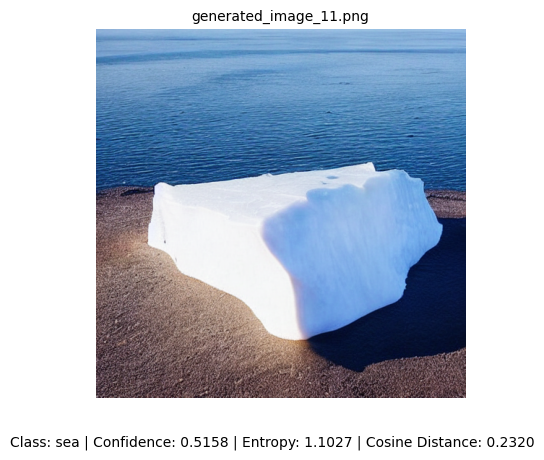

Evaluating images:  80%|████████  | 16/20 [00:03<00:00,  4.07it/s]

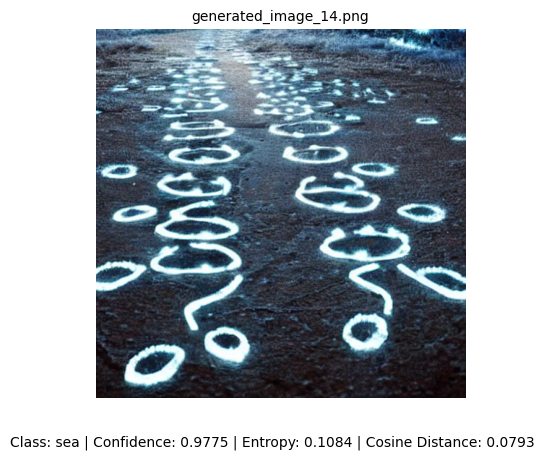

Evaluating images:  85%|████████▌ | 17/20 [00:04<00:00,  4.10it/s]

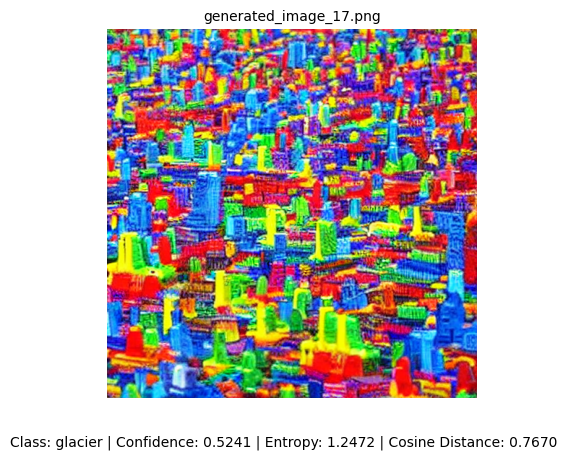

Evaluating images:  90%|█████████ | 18/20 [00:04<00:00,  4.15it/s]

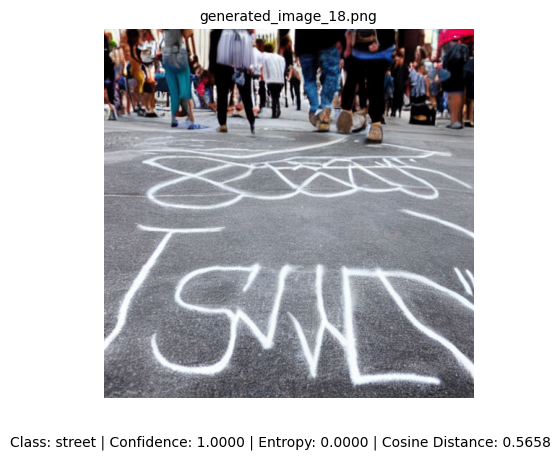

Evaluating images:  95%|█████████▌| 19/20 [00:04<00:00,  4.06it/s]

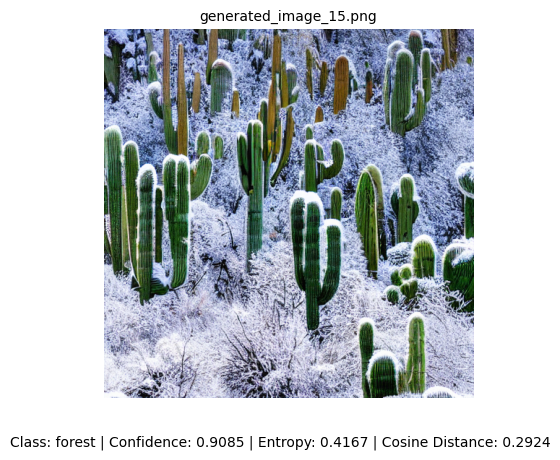

Computing accuracy: 100%|██████████| 20/20 [00:00<00:00, 53.95it/s]


Test Accuracy (ResNet): 60.00% (12/20)


In [14]:
# Feature extractor
featureEx = nn.Sequential(*list(IntelRN.children())[:-1]).to(device)
featureEx.eval()

# Feature extraction function
def extractFeatures(model, imgTensor):
    with torch.no_grad():
        features = model(imgTensor.to(device))
        return features.view(features.size(0), -1).cpu().numpy().squeeze()

# Cache features for ID samples
def getIndFeatures(n=512):
    features = []
    for i, (img, _) in enumerate(tqdm(subset_loader, total=n, desc="Caching ID features")):
        img_feat = extractFeatures(featureEx, img)
        features.append(img_feat)
        if i == n - 1:
            break
    return features

indFeatures = getIndFeatures()

# Entropy calculator
def computeEntropy(prob):
    return -np.sum(prob * np.log(prob + 1e-10))

# Prediction wrapper
def predict(model, imgTensor):
    with torch.no_grad():
        logits = model(imgTensor.to(device))
        probs = torch.softmax(logits, dim=1).cpu().numpy()
        return probs, torch.argmax(logits, dim=1).item()

# Visualizing and evaluating test folder images
def evaluateImages(folder_path):
    imgFiles = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
    for imgName in tqdm(imgFiles, desc="Evaluating images"):
        imgPath = os.path.join(folder_path, imgName)
        try:
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)

            probs, pred_idx = predict(IntelRN, imgTensor)
            confidence = np.max(probs)
            entropy = computeEntropy(probs.squeeze())

            testFeat = extractFeatures(featureEx, imgTensor)
            refFeat = random.choice(indFeatures).reshape(-1)
            cosine_dist = cosine(testFeat, refFeat)

            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{imgName}", fontsize=10)
            plt.figtext(0.5, 0.01,
                        f"Class: {classesIN[pred_idx]} | Confidence: {confidence:.4f} | "
                        f"Entropy: {entropy:.4f} | Cosine Distance: {cosine_dist:.4f}",
                        wrap=True, horizontalalignment='center', fontsize=10)
            plt.show()

        except Exception as e:
            print(f"Could not process image {imgName}: {e}")

# Accuracy computation using groundtruth.xlsx
def TestAcc(xlsx_path, image_dir):
    df = pd.read_excel(xlsx_path)
    correct = 0
    total = 0

    for _, row in tqdm(df.iterrows(), total=len(df), desc="Computing accuracy"):
        baseName = row['Name']
        truelabelName = row['Class']
        truelabel = class_to_idx.get(truelabelName)

        if truelabel is None:
            print(f"Unknown label '{truelabelName}' for {baseName}")
            continue

        possNames = [f"{baseName}.png", f"{baseName}.jpg", f"{baseName}.jpeg"]
        imgPath = None
        for name in possNames:
            full_path = os.path.join(image_dir, name)
            if os.path.exists(full_path):
                imgPath = full_path
                break

        if imgPath is None:
            print(f"Image not found for: {baseName}")
            continue

        try:
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)
            _, pred_idx = predict(IntelRN, imgTensor)

            if pred_idx == truelabel:
                correct += 1
            total += 1
        except Exception as e:
            print(f"Error processing {baseName}: {e}")

    accuracy = correct / total if total > 0 else 0
    print(f"\nTest Accuracy (ResNet): {accuracy * 100:.2f}% ({correct}/{total})")

# Evaluation paths
test_folder = "/kaggle/input/intel-generatedset"  # Update if needed
xlsx_path = os.path.join(test_folder, "groundtruth.xlsx")

# Run evaluations
evaluateImages(test_folder)
TestAcc(xlsx_path, test_folder)

# Testing EfficientNet-B0 model on my Testing Set

Evaluating images:   0%|          | 0/20 [00:00<?, ?it/s]

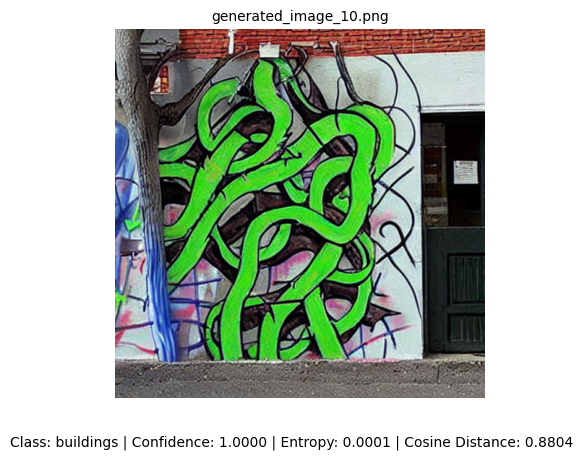

Evaluating images:   5%|▌         | 1/20 [00:00<00:05,  3.50it/s]

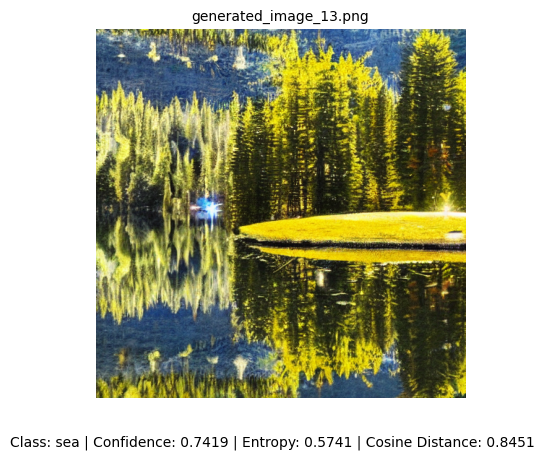

Evaluating images:  10%|█         | 2/20 [00:00<00:04,  3.62it/s]

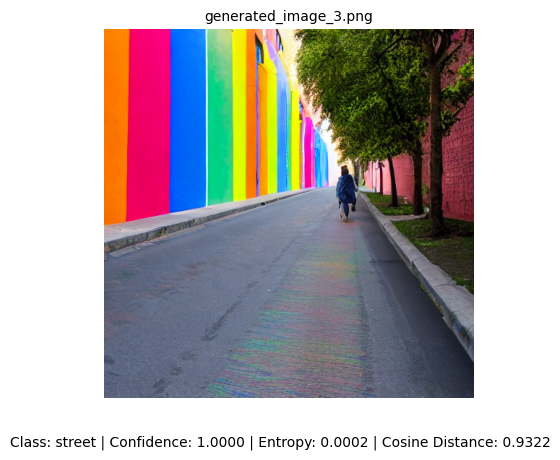

Evaluating images:  15%|█▌        | 3/20 [00:00<00:04,  3.46it/s]

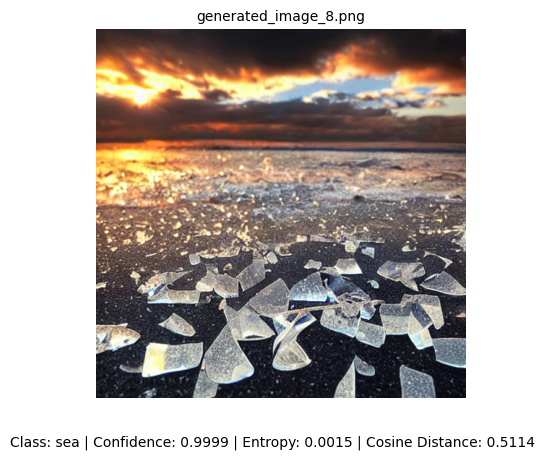

Evaluating images:  20%|██        | 4/20 [00:01<00:04,  3.61it/s]

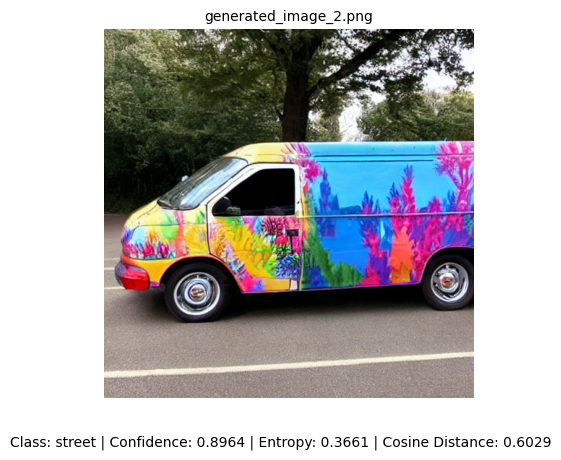

Evaluating images:  25%|██▌       | 5/20 [00:01<00:04,  3.69it/s]

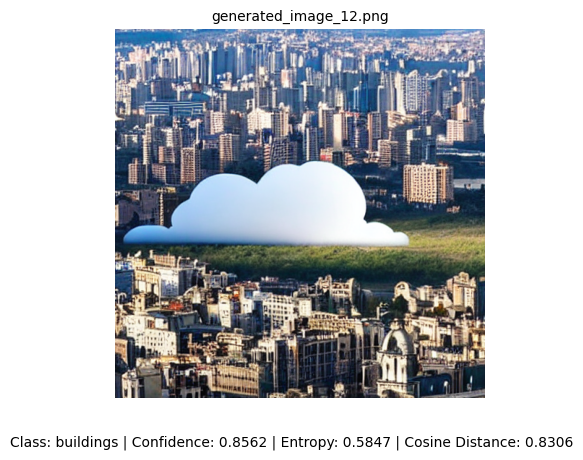

Evaluating images:  30%|███       | 6/20 [00:01<00:03,  3.79it/s]

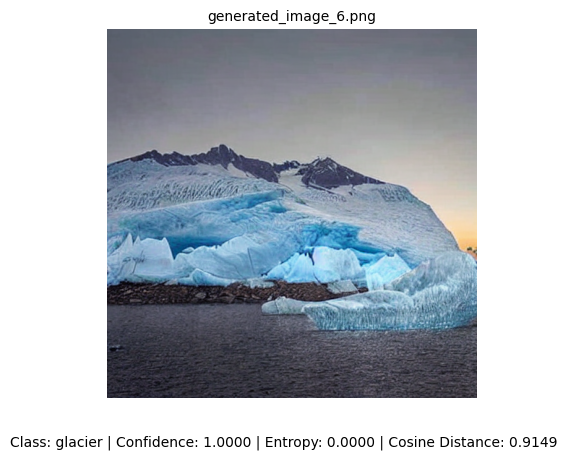

Evaluating images:  35%|███▌      | 7/20 [00:01<00:03,  3.83it/s]

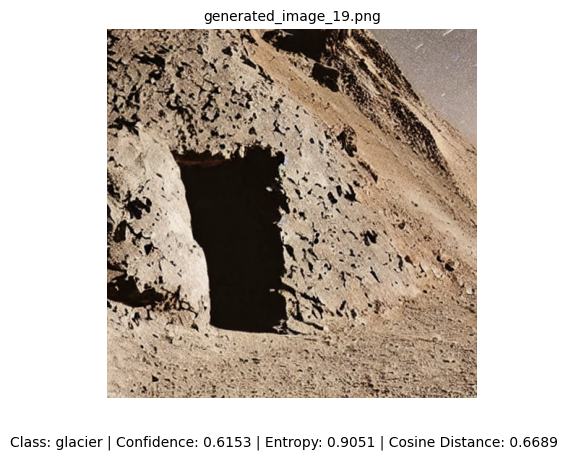

Evaluating images:  40%|████      | 8/20 [00:02<00:03,  3.89it/s]

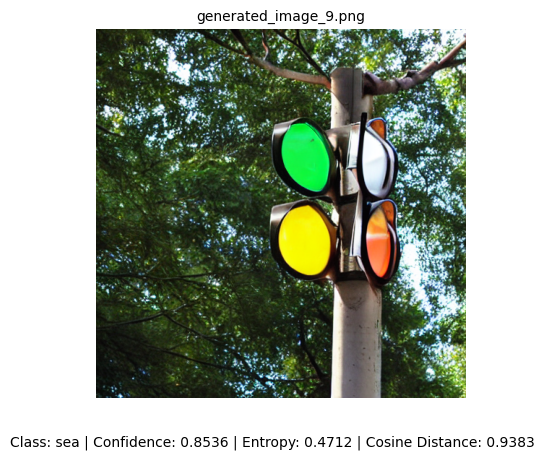

Evaluating images:  45%|████▌     | 9/20 [00:02<00:02,  3.92it/s]

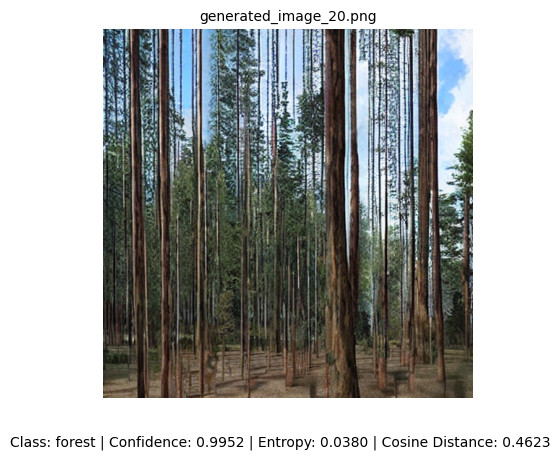

Evaluating images:  50%|█████     | 10/20 [00:02<00:02,  3.96it/s]

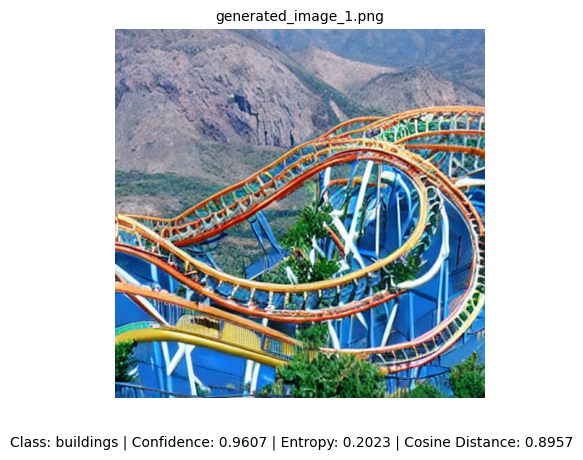

Evaluating images:  55%|█████▌    | 11/20 [00:02<00:02,  3.95it/s]

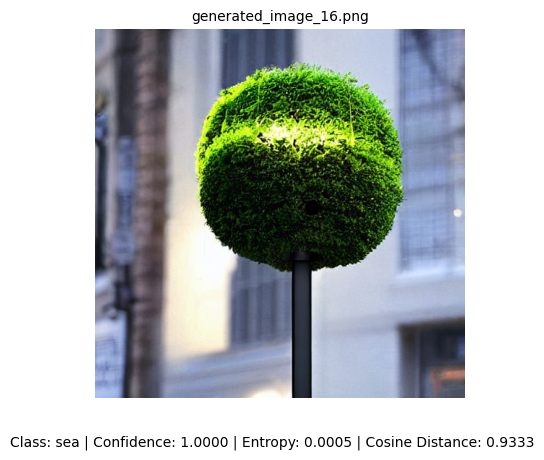

Evaluating images:  60%|██████    | 12/20 [00:03<00:02,  3.91it/s]

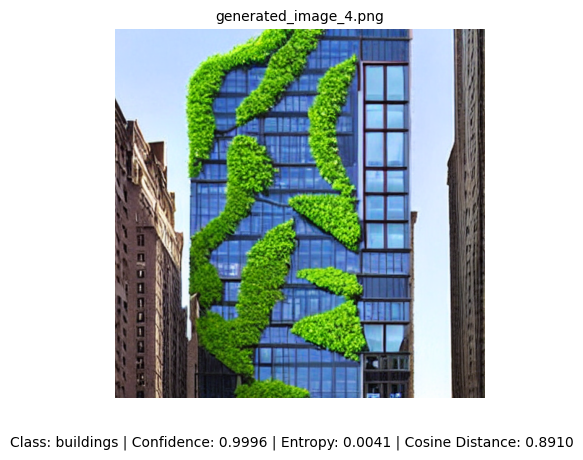

Evaluating images:  65%|██████▌   | 13/20 [00:03<00:01,  3.89it/s]

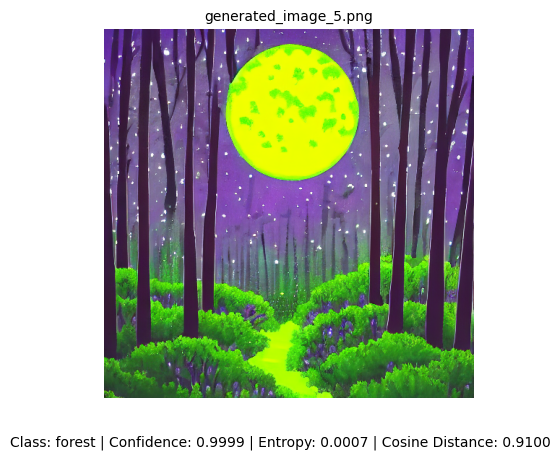

Evaluating images:  70%|███████   | 14/20 [00:03<00:01,  3.91it/s]

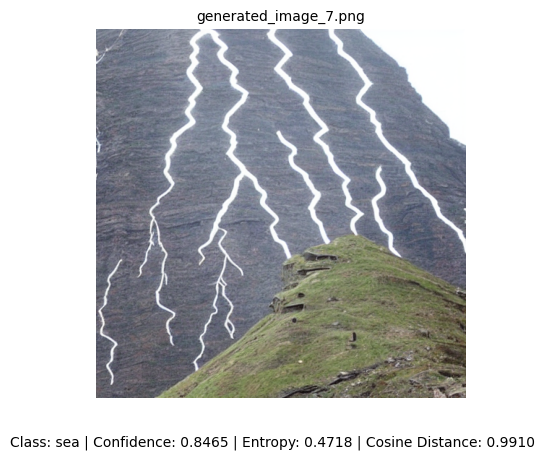

Evaluating images:  75%|███████▌  | 15/20 [00:03<00:01,  3.92it/s]

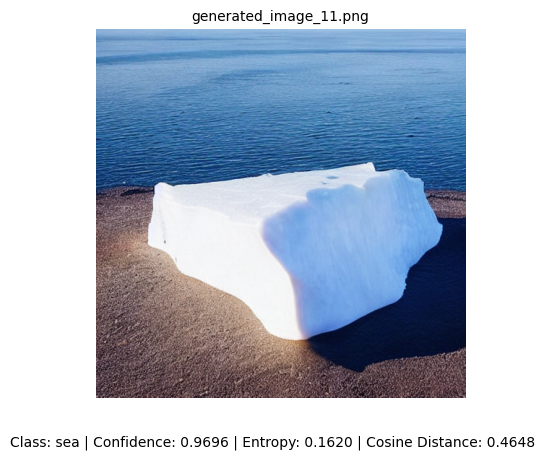

Evaluating images:  80%|████████  | 16/20 [00:04<00:01,  3.91it/s]

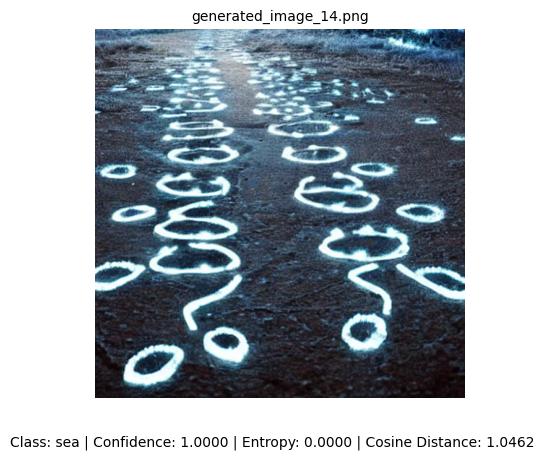

Evaluating images:  85%|████████▌ | 17/20 [00:04<00:00,  4.00it/s]

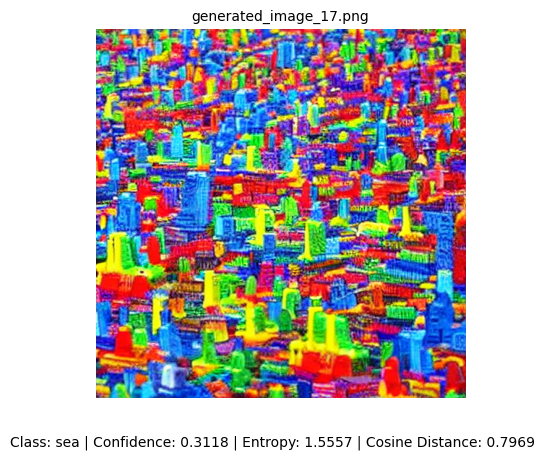

Evaluating images:  90%|█████████ | 18/20 [00:04<00:00,  4.07it/s]

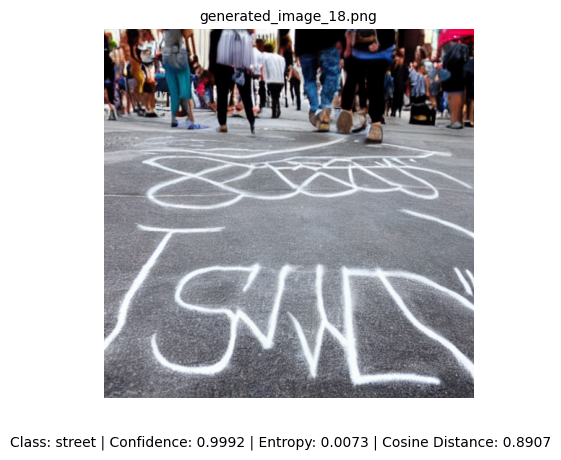

Evaluating images:  95%|█████████▌| 19/20 [00:04<00:00,  4.02it/s]

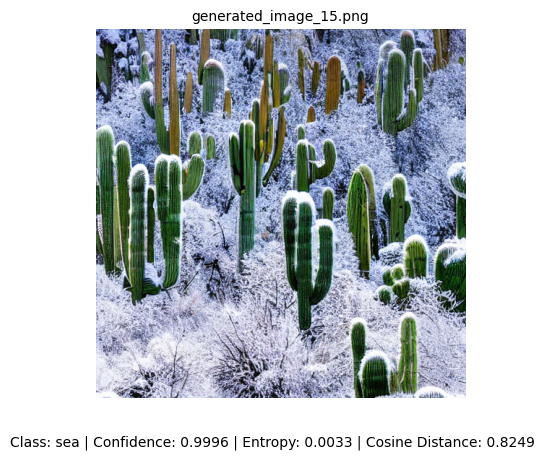

Computing accuracy: 100%|██████████| 20/20 [00:00<00:00, 42.93it/s]


Test Accuracy: 40.00% (8/20)


In [15]:
# Creating a feature extractor from EfficientNet-B0 by removing the classification head
featureEx = nn.Sequential(*list(IntelEN.children())[:-1]).to(device)
featureEx.eval()

# Defining a function for extracting features from a single image tensor
def extractFeatures(IntelEN, imgTensor):
    with torch.no_grad():
        features = IntelEN(imgTensor.to(device))
        return features.view(features.size(0), -1).cpu().numpy().squeeze()

# Caching in-distribution features from the subset loader
def getIndFeatures(n=512):
    features = []
    for i, (img, _) in enumerate(tqdm(subset_loader, total=n, desc="Caching ID features")):
        img_feat = extractFeatures(featureEx, img)
        features.append(img_feat)
        if i == n - 1:
            break
    return features

# Extracting ID features for similarity comparison
indFeatures = getIndFeatures()

# Calculating entropy from the predicted class probabilities
def computeEntropy(prob):
    return -np.sum(prob * np.log(prob + 1e-10))

# Making predictions using EfficientNet-B0 and returning softmax probabilities and predicted class
def predict(IntelEN, imgTensor):
    with torch.no_grad():
        logits = IntelEN(imgTensor.to(device))
        probs = torch.softmax(logits, dim=1).cpu().numpy()
        return probs, torch.argmax(logits, dim=1).item()

# Evaluating and visualizing images in a specified folder
def evaluateImages(folder_path):
    imgFiles = [f for f in os.listdir(folder_path) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]
    for imgName in tqdm(imgFiles, desc="Evaluating images"):
        imgPath = os.path.join(folder_path, imgName)
        try:
            # Loading and transforming the image
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)

            # Getting predictions and statistics
            probs, pred_idx = predict(IntelEN, imgTensor)
            confidence = np.max(probs)
            entropy = computeEntropy(probs.squeeze())

            # Extracting features and comparing with a random ID reference
            testFeat = extractFeatures(featureEx, imgTensor)
            refFeat = random.choice(indFeatures).reshape(-1)
            cosine_dist = cosine(testFeat, refFeat)

            # Showing the image and prediction details
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{imgName}", fontsize=10)
            plt.figtext(0.5, 0.01,
                        f"Class: {classesIN[pred_idx]} | Confidence: {confidence:.4f} | "
                        f"Entropy: {entropy:.4f} | Cosine Distance: {cosine_dist:.4f}",
                        wrap=True, horizontalalignment='center', fontsize=10)
            plt.show()
        except Exception as e:
            print(f"Could not process image {imgName}: {e}")

# Computing test accuracy from a ground truth Excel file
def TestAcc(xlsx_path, image_dir):
    df = pd.read_excel(xlsx_path)
    correct = 0
    total = 0

    for _, row in tqdm(df.iterrows(), total=len(df), desc="Computing accuracy"):
        baseName = row['Name']
        truelabelName = row['Class']
        truelabel = class_to_idx.get(truelabelName)

        if truelabel is None:
            print(f"Unknown label '{truelabelName}' for {baseName}")
            continue

        # Trying all possible image extensions
        possNames = [f"{baseName}.png", f"{baseName}.jpg", f"{baseName}.jpeg"]
        imgPath = None
        for name in possNames:
            full_path = os.path.join(image_dir, name)
            if os.path.exists(full_path):
                imgPath = full_path
                break

        if imgPath is None:
            print(f"Image not found for: {baseName}")
            continue

        try:
            # Loading image and making prediction
            img = Image.open(imgPath).convert("RGB")
            imgTensor = transform(img).unsqueeze(0)
            _, pred_idx = predict(IntelEN, imgTensor)

            # Updating counters based on prediction correctness
            if pred_idx == truelabel:
                correct += 1
            total += 1
        except Exception as e:
            print(f"Error processing {baseName}: {e}")

    # Printing final test accuracy
    accuracy = correct / total if total > 0 else 0
    print(f"\nTest Accuracy: {accuracy * 100:.2f}% ({correct}/{total})")

# Setting paths
test_folder = "/kaggle/input/intel-generatedset"
xlsx_path = os.path.join(test_folder, "groundtruth.xlsx")

# Running the evaluation and test accuracy calculation
evaluateImages(test_folder)
TestAcc(xlsx_path, test_folder)

# Computing PCS (Perceptual Concept Shift Score)

In [16]:
import torch
import torch.nn.functional as F
from transformers import BlipProcessor, BlipForConditionalGeneration, CLIPProcessor, CLIPModel
from torchvision import models, transforms
from PIL import Image
import numpy as np
import os

# Loading the models for captioning and similarity comparison
blip_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")

# Loading the ResNet-18 pretrained model for classification and confidence prediction
ResnetM = models.resnet18(pretrained=True)
ResnetM.eval()  # Setting the model to evaluation mode

# Preprocessing images for ResNet
preprocess_resnet = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Loading an image and converting it to RGB format
def loadImg(path):
    return Image.open(path).convert("RGB")

# Calculating the Perceptual Concept Shift (PCS) score based on the image and caption
def calpcs(image, caption):
    # Preprocessing the image for CLIP and computing cosine similarity
    inputs = clip_processor(text=[caption], images=image, return_tensors="pt", padding=True)
    with torch.no_grad():
        clip_outputs = clip_model(**inputs)
        clip_image_embeds = clip_outputs.image_embeds
        clip_text_embeds = clip_outputs.text_embeds
        cosine_similarity = F.cosine_similarity(clip_image_embeds, clip_text_embeds)
    
    return cosine_similarity.item()  # Returning the PCS score

# Predicting class and confidence score using ResNet-18
def resnetPredict(image):
    # Preprocessing the image and passing it through ResNet
    image_tensor = preprocess_resnet(image).unsqueeze(0)
    with torch.no_grad():
        outputs = ResnetM(image_tensor)
        probabilities = F.softmax(outputs, dim=1)
        confidence, predictedClass = torch.max(probabilities, 1)
    return predictedClass.item(), confidence.item()

# Setting the initial PCS threshold and adjusting factor based on ResNet confidence
pcs_threshold = 0.304
pcs_threshold_adjustment_factor = 0.1  # Factor to adjust threshold based on ResNet confidence

# Classifying images based on PCS score and ResNet confidence
def classifyImg(path, caption):
    # Loading the image
    image = loadImg(path)

    # Calculating the PCS score for the image
    pcs_score = calpcs(image, caption)
    predictedClass, resnetConfidence = resnetPredict(image)

    # Dynamically adjusting the PCS threshold based on ResNet's confidence score
    dynamicThresh = pcs_threshold + (1 - resnetConfidence) * pcs_threshold_adjustment_factor

    # Classifying as in-distribution (ID) or out-of-distribution (OOD) based on PCS score and dynamic threshold
    status = "Likely In-Distribution" if pcs_score <= dynamicThresh else "Likely OOD"
    return {
        "Image": path,
        "Caption": caption,
        "PCS Score": pcs_score,
        "ResNet Prediction Class": predictedClass,
        "Confidence": resnetConfidence,
        "Status": status
    }

# Defining the test set directory path
test_image_dir = "/kaggle/input/testset"
results = []

# Iterating through the test set and processing each image
for image_file in os.listdir(test_image_dir):
    path = os.path.join(test_image_dir, image_file)
    
    # Generating a caption for the image using BLIP
    rawImg = loadImg(path)
    inputs = blip_processor(rawImg, return_tensors="pt")
    out = blip_model.generate(**inputs)
    caption = blip_processor.decode(out[0], skip_special_tokens=True)

    # Classifying the image based on PCS score and ResNet prediction
    result = classifyImg(path, caption)
    results.append(result)

# Displaying results for each image
for result in results:
    print(f"Image: {result['Image']}")
    print(f"Caption: {result['Caption']}")
    print(f"PCS Score: {result['PCS Score']}")
    print(f"ResNet Prediction Class: {result['ResNet Prediction Class']} (Confidence: {result['Confidence']:.2f})")
    print(f"Status: {result['Status']}")
    print("-" * 50)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

Image: /kaggle/input/testset/generated_image_10.png
Caption: a cup of coffee with a mustache on it
PCS Score: 0.34515827894210815
ResNet Prediction Class: 967 (Confidence: 0.61)
Status: Likely OOD
--------------------------------------------------
Image: /kaggle/input/testset/generated_image_13.png
Caption: a cup of coffee with a red handle
PCS Score: 0.3041701316833496
ResNet Prediction Class: 967 (Confidence: 0.19)
Status: Likely In-Distribution
--------------------------------------------------
Image: /kaggle/input/testset/generated_image_3.png
Caption: a person holding a pen with a flower on it
PCS Score: 0.3686293363571167
ResNet Prediction Class: 418 (Confidence: 0.41)
Status: Likely OOD
--------------------------------------------------
Image: /kaggle/input/testset/generated_image_8.png
Caption: a white sculpture on a wooden floor
PCS Score: 0.2867157757282257
ResNet Prediction Class: 999 (Confidence: 0.39)
Status: Likely In-Distribution
-----------------------------------------